In [41]:
import pandas as pd
import psycopg2
import pandas.io.sql as psql
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
from shapely.geometry import Point
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from statsmodels.distributions.empirical_distribution import ECDF
from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score
from sklearn.multioutput import MultiOutputClassifier
from scipy.sparse import hstack
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import balanced_accuracy_score
from sklearn.decomposition import TruncatedSVD
from sklearn.preprocessing import MaxAbsScaler
from sklearn.preprocessing import scale
from sklearn.svm import SVC
from sklearn.manifold import TSNE
%matplotlib inline

# Carga de datos

In [42]:
usecols = [
    "id",
    "place_name",
    "place_country",
    "latitude",
    "longitude"
]

In [43]:
total_users = pd.read_pickle("../../../../dosT/ffunes/total_users_parsed.pkl")

In [44]:
total_users = total_users.loc[:, usecols]

In [45]:
total_users.shape

(176029, 5)

In [46]:
usecols = [
    "user_id",
    "hashtags",
    "mentions_country"
]

In [47]:
users_with_hashtags = pd.read_pickle("../../../../dosT/ffunes/users_with_hashtags.pkl")

In [48]:
users_with_hashtags = users_with_hashtags.loc[:, usecols]

In [49]:
users_with_hashtags.shape

(65206, 3)

In [50]:
usecols = [
    "user_id",
    "users_mentioned"
]

In [51]:
users_with_mentions = pd.read_pickle("../../../../dosT/ffunes/users_with_mentions.pkl")

In [52]:
users_with_mentions = users_with_mentions.loc[:, usecols]

In [53]:
users_with_mentions.shape

(129334, 2)

In [54]:
total_users = pd.merge(
    left=total_users,
    right=users_with_hashtags,
    how='left',
    left_on='id',
    right_on='user_id',
    validate='1:1'
)
del total_users['user_id']

In [55]:
total_users = pd.merge(
    left=total_users,
    right=users_with_mentions,
    how='left',
    left_on='id',
    right_on='user_id',
    validate='1:1'
)
del total_users['user_id']

Veamos que % de usuarios tienen hashtags o menciones

In [56]:
total_users.dropna(subset=["users_mentioned", "hashtags"], how='all').shape[0]

139081

In [57]:
total_users.dropna(subset=["users_mentioned", "hashtags"], how='all').shape[0]/total_users.shape[0]

0.7901027671576842

In [58]:
users_train = total_users.dropna(subset=["users_mentioned", "hashtags"], how='all')

In [59]:
users_train.shape

(139081, 8)

In [60]:
users_train.loc[:, ['hashtags']] = users_train['hashtags'].apply(lambda x: x if isinstance(x, list) else [])
users_train.loc[:, ['mentions_country']] = users_train['mentions_country'].apply(lambda x: x if isinstance(x, list) else [])
users_train.loc[:, ['users_mentioned']] = users_train['users_mentioned'].apply(lambda x: x if isinstance(x, list) else [])

/var/home/ffunes/venv/lib/python3.5/site-packages/pandas/core/indexing.py:543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [61]:
users_train.loc[:, ['users_mentioned']] = users_train["users_mentioned"].apply(lambda l: list(map(str, l)))

In [62]:
users_train["unified_place"] = users_train["place_name"] + ',' + users_train["place_country"]

/var/home/ffunes/venv/lib/python3.5/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


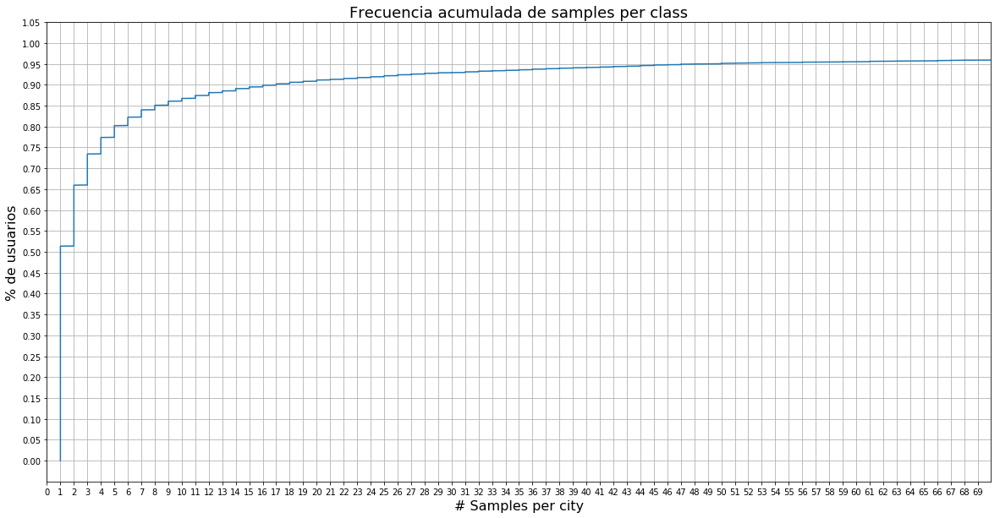

In [63]:
ecdf = ECDF(users_train['unified_place'].value_counts())

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("# Samples per city", fontsize=16)
plt.ylabel("% de usuarios", fontsize=16)
plt.title("Frecuencia acumulada de samples per class", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.05))
plt.xticks(np.arange(0,70,1))
plt.xlim(0, 70)
#plt.hlines(accuracy_score(y_test[:, 0], y_predicted_city), -200, 1000, colors='r', linestyles='dashed')
#plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

In [64]:
min_determined_place = users_train.loc[:, ["id", "unified_place"]].groupby("unified_place").count().sort_values('id', ascending=False).reset_index()

In [65]:
min_determined_place.head(5)

,unified_place,id
0,"ciudad autónoma de buenos aires,argentina",23980
1,"córdoba,argentina",5965
2,"rosario,argentina",4588
3,"la plata,argentina",3319
4,"mar del plata,argentina",2408


In [66]:
min_determined_place["id"].median()

1.0

In [67]:
min_determined_place.shape

(6015, 2)

# Mínimo de muestras por clase para entrenar

In [68]:
min_determined_place = min_determined_place.loc[min_determined_place["id"] >= 799, :]

In [69]:
min_determined_place.shape

(29, 2)

In [30]:
users_train_selected = pd.merge(
    left=users_train,
    right=min_determined_place.loc[:, ['unified_place']],
    how='inner',
    left_on='unified_place',
    right_on='unified_place',
    validate='m:1'
)
users_train_selected.shape

(54099, 9)

In [31]:
users_train_only_hashtags = users_train.copy()
users_train_only_hashtags = users_train_only_hashtags[users_train_only_hashtags['hashtags'].map(lambda d: len(d)) > 0]
min_determined_place = users_train_only_hashtags.loc[:, ["id", "unified_place"]].groupby("unified_place").count().sort_values('id', ascending=False).reset_index()
min_determined_place = min_determined_place.loc[min_determined_place["id"] >= 500, :]

users_train_only_hashtags = pd.merge(
    left=users_train_only_hashtags,
    right=min_determined_place.loc[:, ['unified_place']],
    how='inner',
    left_on='unified_place',
    right_on='unified_place',
    validate='m:1'
)

print(users_train_only_hashtags.shape, min_determined_place.shape)

(31493, 9) (23, 2)


In [32]:
users_train_only_mentions = users_train.copy()
users_train_only_mentions = users_train_only_mentions[users_train_only_mentions['users_mentioned'].map(lambda d: len(d)) > 0]
min_determined_place = users_train_only_mentions.loc[:, ["id", "unified_place"]].groupby("unified_place").count().sort_values('id', ascending=False).reset_index()
min_determined_place = min_determined_place.loc[min_determined_place["id"] >= 670, :]

users_train_only_mentions = pd.merge(
    left=users_train_only_mentions,
    right=min_determined_place.loc[:, ['unified_place']],
    how='inner',
    left_on='unified_place',
    right_on='unified_place',
    validate='m:1'
)

print(users_train_only_mentions.shape, min_determined_place.shape)

(46090, 9) (23, 2)


In [33]:
class_names = sorted(users_train_selected['unified_place'].unique())
class_names_hashtags = sorted(users_train_only_hashtags['unified_place'].unique())
class_names_mentions = sorted(users_train_only_mentions['unified_place'].unique())

#class_names = users_train_selected['place_country'].unique()

In [34]:
users_complete_location = users_train_selected.loc[:, ["unified_place", "latitude", "longitude"]].values
users_complete_location_hashtags = users_train_only_hashtags.loc[:, ["unified_place", "latitude", "longitude"]].values
users_complete_location_mentions = users_train_only_mentions.loc[:, ["unified_place", "latitude", "longitude"]].values
#users_complete_location = users_train_selected.loc[:, ["place_country", "latitude", "longitude"]].values

# Función para mostrar árboles

In [35]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
import graphviz 

def show_tree(estimator, feature_names, class_names):
    dot_data = StringIO()

    export_graphviz(estimator, 
                    out_file=dot_data,
                    feature_names = feature_names,
                    class_names = class_names,
                    filled=True,
                    rounded=True,
                    special_characters=True)

    graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
    return Image(graph.create_png())

/var/home/ffunes/venv/lib/python3.5/site-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)


# Función para calcular distancias entre datos predecidos y reales

In [36]:
geonames = pd.read_pickle("../../../../dosT/ffunes/geonames_parsed.pkl")

from math import radians, sin, cos, atan2, sqrt

def haversine_distance(lat1, lon1, lat2, lon2):
    radius = 6371 # km

    dlat = radians(lat2-lat1)
    dlon = radians(lon2-lon1)
    a = sin(dlat/2) * sin(dlat/2) + cos(radians(lat1)) \
        * cos(radians(lat2)) * sin(dlon/2) * sin(dlon/2)
    c = 2 * atan2(sqrt(a), sqrt(1-a))
    d = radius * c

    return d

def determine_distance(row):
    predicted_lat = row['predicted_lat']
    predicted_lon = row['predicted_lon']
    real_lat = row['real_lat']
    real_long = row['real_lon']
    
    return haversine_distance(predicted_lat, predicted_lon, real_lat, real_long)

def get_difference_distance(predicted_place, real_place):
    df_prediction = pd.DataFrame({
        'predicted_place': predicted_place,
        'real_place': real_place
    }, dtype=float)
        
    df_prediction[['predicted_cities','predicted_countries']] = df_prediction.predicted_place.str.split(',', expand=True) 
    df_prediction[['real_cities','real_countries']] = df_prediction.real_place.str.split(',', expand=True) 
    
    del df_prediction['predicted_place']
    del df_prediction['real_place']
    
    df_prediction = pd.merge(
        left=df_prediction,
        right=geonames.loc[:,['alternatenames', 'country', 'latitude', 'longitude']],
        how='left',
        left_on=['predicted_cities', 'predicted_countries'],
        right_on=['alternatenames', 'country'],
        validate='m:1'
    )
    
    df_prediction.rename(columns={'latitude': 'predicted_lat', 'longitude': 'predicted_lon'}, inplace=True)
    
    del df_prediction['alternatenames']
    del df_prediction['country']
    
    df_prediction = pd.merge(
        left=df_prediction,
        right=geonames.loc[:,['alternatenames', 'country', 'latitude', 'longitude']],
        how='left',
        left_on=['real_cities', 'real_countries'],
        right_on=['alternatenames', 'country'],
        validate='m:1'
    )
    
    del df_prediction['alternatenames']
    del df_prediction['country']
    
    df_prediction.rename(columns={'latitude': 'real_lat', 'longitude': 'real_lon'}, inplace=True)
    
    #print(df_prediction.head(5))
    
    print("Total NaN: ", df_prediction.shape[0]-df_prediction.dropna(subset=['real_lat', 'real_lon', 'predicted_lat', 'predicted_lon']).shape[0])

    return df_prediction.apply(determine_distance, axis=1)

# Predicción usando solo hashtags

In [37]:
vectorizer = CountVectorizer(
    strip_accents="ascii",
    lowercase=True,
)

vector_of_hashtags = vectorizer.fit_transform(users_train_only_hashtags["hashtags"].apply(lambda x: ' '.join(x))).astype('bool')
vector_of_hashtags

<31493x4786 sparse matrix of type '<class 'numpy.bool_'>'
	with 231216 stored elements in Compressed Sparse Row format>

In [38]:
hashtag_list = vectorizer.get_feature_names()

In [39]:
vectorizer = CountVectorizer(
    strip_accents="ascii",
    lowercase=True,
)

vector_of_hashtags_countries = vectorizer.fit_transform(users_train_only_hashtags["mentions_country"].apply(lambda x: ' '.join(x))).astype('bool')
vector_of_hashtags_countries

<31493x15 sparse matrix of type '<class 'numpy.bool_'>'
	with 1191 stored elements in Compressed Sparse Row format>

In [40]:
mentioned_places = vectorizer.get_feature_names()

In [41]:
feature_names = hashtag_list + mentioned_places#mentions_list

In [42]:
vector = hstack([vector_of_hashtags,vector_of_hashtags_countries])#, vector_of_mentions])

In [43]:
vector

<31493x4801 sparse matrix of type '<class 'numpy.bool_'>'
	with 232407 stored elements in COOrdinate format>

# Hashtags - sin generar muestras

In [44]:
X_train, X_test, y_train, y_test = train_test_split(vector, users_complete_location_hashtags[:,0], test_size=0.30)

DecisionTree

In [50]:
decisiontree = DecisionTreeClassifier()
decisiontree.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [83]:
param_grid= {'max_features': [10, 20, 50, 'auto', 1000, 2000, None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1, 2, 10],
             'class_weight': ['balanced']}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

{'class_weight': 'balanced', 'max_depth': 500, 'min_samples_leaf': 1, 'max_features': 2000} 0.3473803583579043


In [84]:
y_predicted = grid_drop.predict(X_test)

In [85]:
accuracy_score(y_test, y_predicted)

0.3515029635901778

In [86]:
balanced_accuracy_score(y_test, y_predicted)

0.28228303066950744

In [87]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


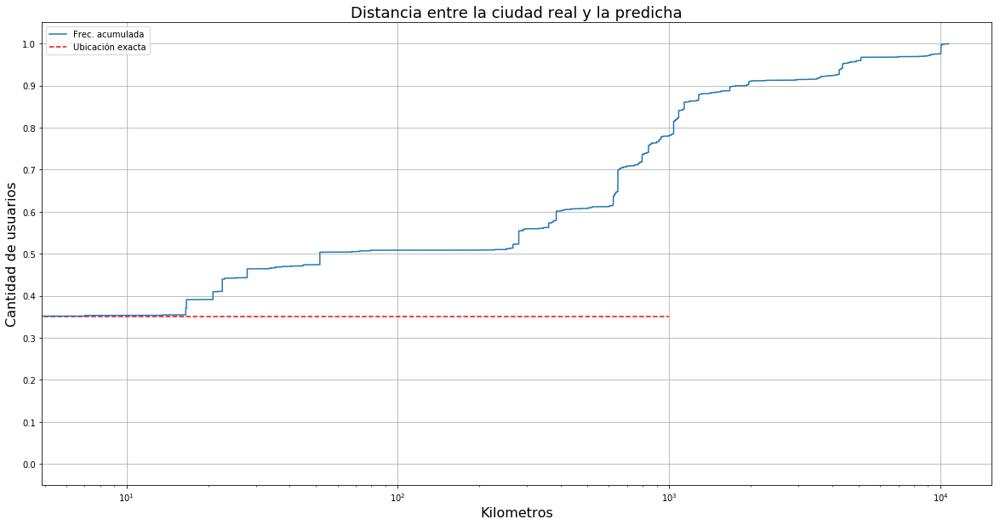

In [88]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

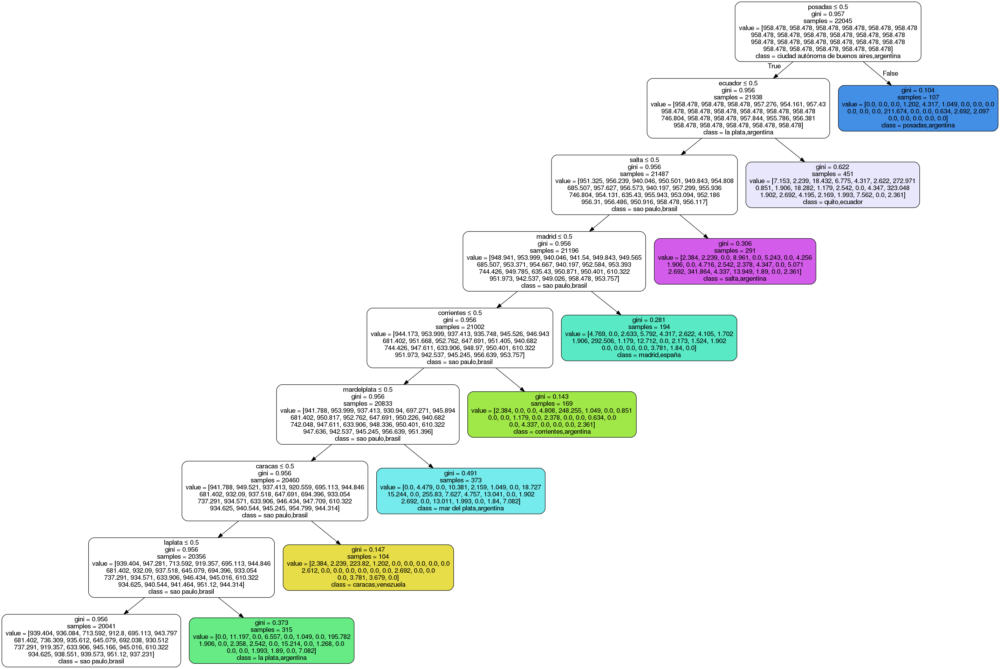

In [105]:
show_tree(grid_drop.best_estimator_, feature_names, sorted(class_names_hashtags))

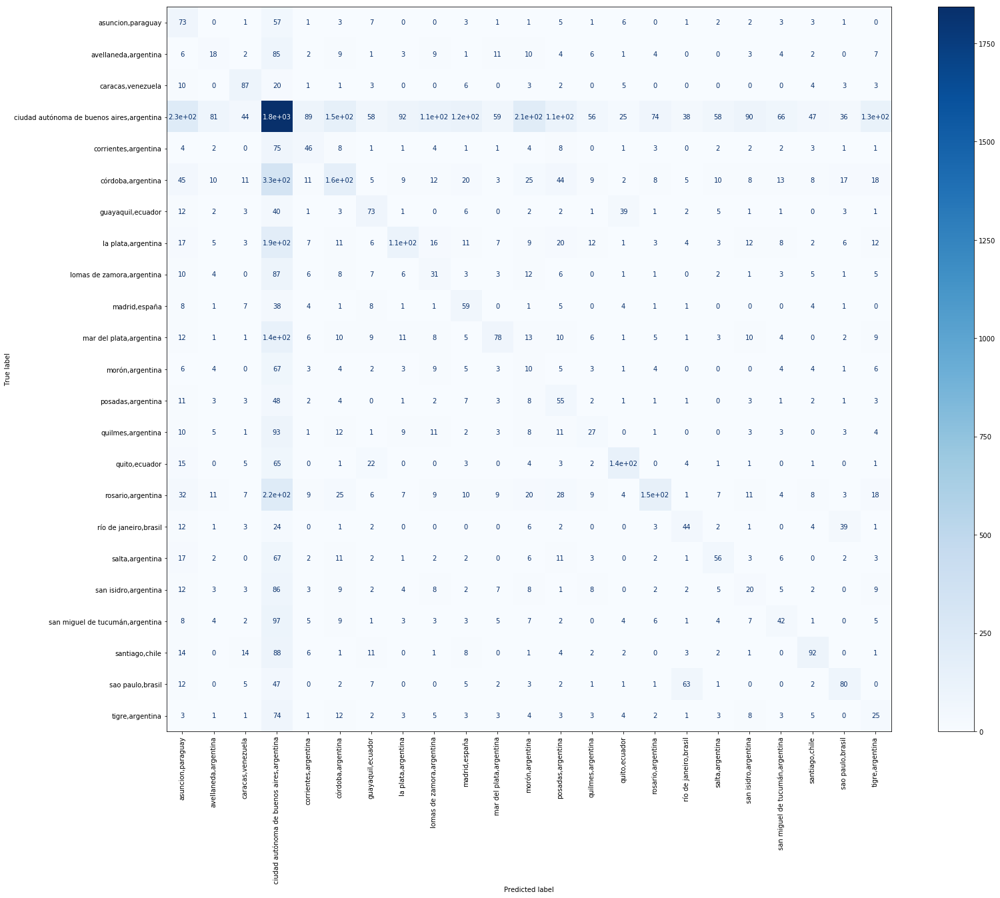

In [89]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_hashtags,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

RandomForest

In [52]:
randomforest = RandomForestClassifier()
randomforest.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}

In [56]:
param_grid= {'max_depth': [200], 'class_weight': ['balanced'], 'min_samples_leaf': [1], 'max_features': [2000]}

grid_drop = GridSearchCV(randomforest, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

{'max_depth': 200, 'class_weight': 'balanced', 'min_samples_leaf': 1, 'max_features': 2000} 0.3754592878203674


In [57]:
y_predicted = grid_drop.predict(X_test)

In [58]:
accuracy_score(y_test, y_predicted)

0.38505503810330227

In [59]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


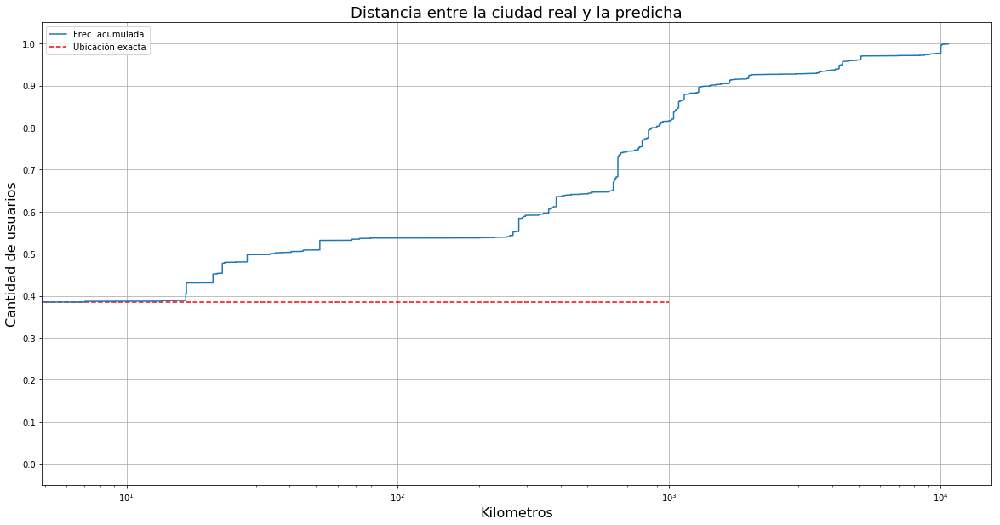

In [60]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

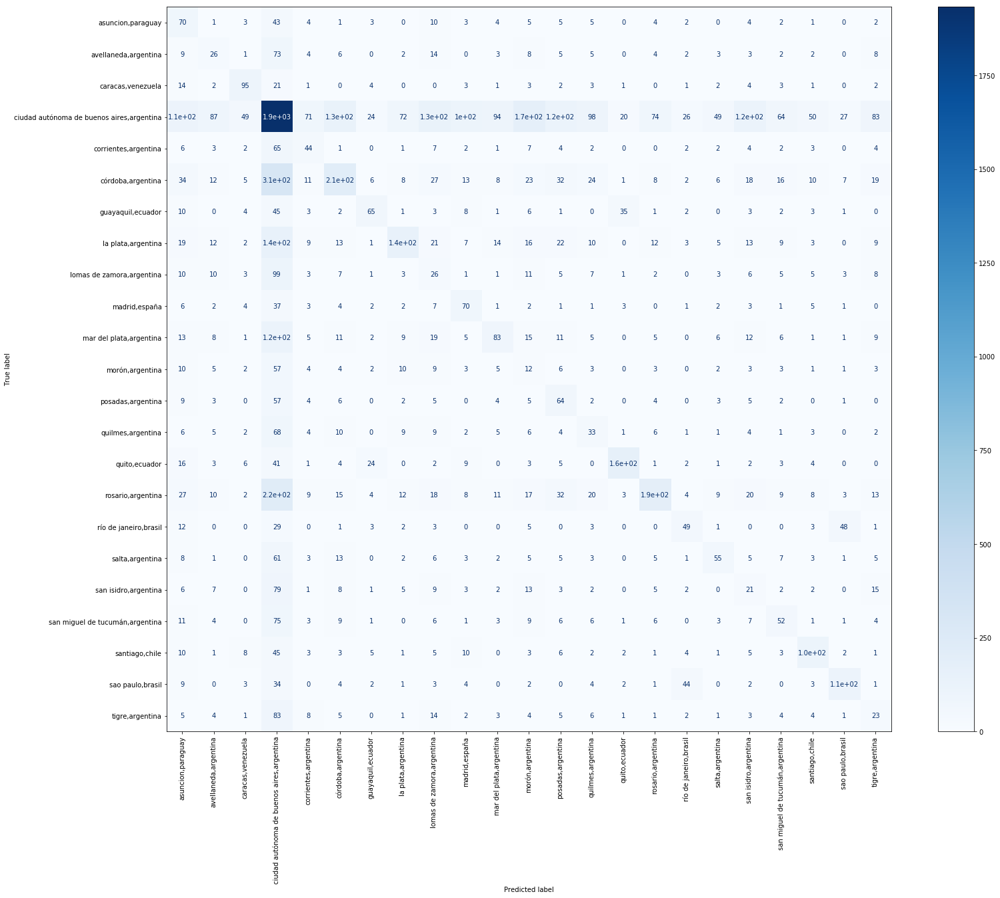

In [61]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_hashtags,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

SVM

In [46]:
X_train

<22045x4801 sparse matrix of type '<class 'numpy.bool_'>'
	with 161718 stored elements in Compressed Sparse Row format>

In [47]:
scaler = MaxAbsScaler().fit(X_train)
X_train = scaler.transform(X_train)

In [47]:
svc = SVC()
svc.get_params()

{'C': 1.0,
 'break_ties': False,
 'cache_size': 200,
 'class_weight': None,
 'coef0': 0.0,
 'decision_function_shape': 'ovr',
 'degree': 3,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'probability': False,
 'random_state': None,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [200]:
param_grid= {'C': [pow(2, -5), pow(2, -3), pow(2, -1), 0.1, 0.5, 1.0, pow(2, 3), pow(2, 5), pow(2, 15)],
             'gamma': ['scale', 'auto', pow(2, -15), pow(2, -13), pow(2, -8), pow(2, -5), pow(2, -3)],
    'class_weight': ['balanced'], 'cache_size': [2000.0]}

grid_drop = GridSearchCV(svc, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

{'cache_size': 2000.0, 'class_weight': 'balanced', 'C': 0.1, 'gamma': 'auto'} 0.396234973916988


In [201]:
y_predicted = grid_drop.predict(X_test)

In [202]:
accuracy_score(y_test, y_predicted)

0.39892040643522436

In [203]:
balanced_accuracy_score(y_test, y_predicted)

0.043478260869565216

In [204]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


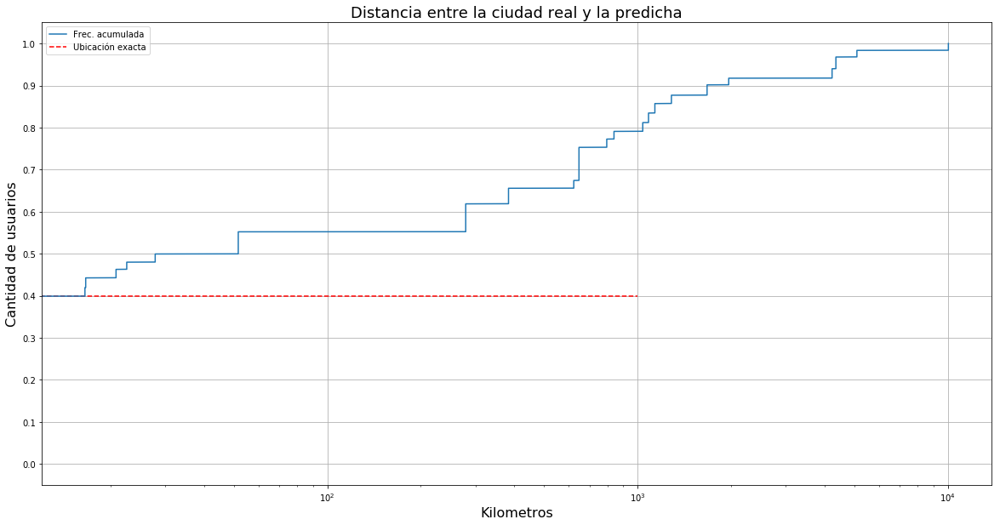

In [205]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

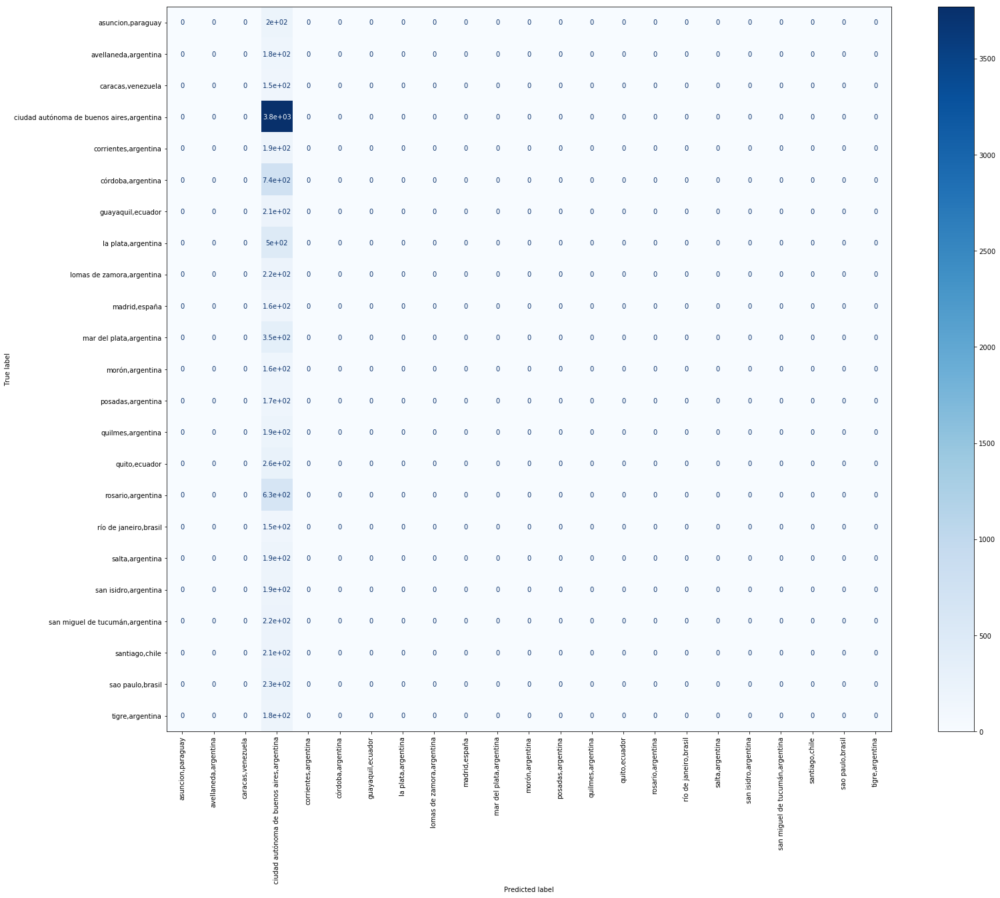

In [206]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_hashtags,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

Reducción de dimensiones

In [45]:
X_train.get_shape()[1]

4801

In [46]:
svd = TruncatedSVD(n_components=2000)

In [47]:
X_train_svd = svd.fit_transform(X_train)

In [48]:
svd.explained_variance_ratio_.cumsum()[-1]

0.9687055910334516

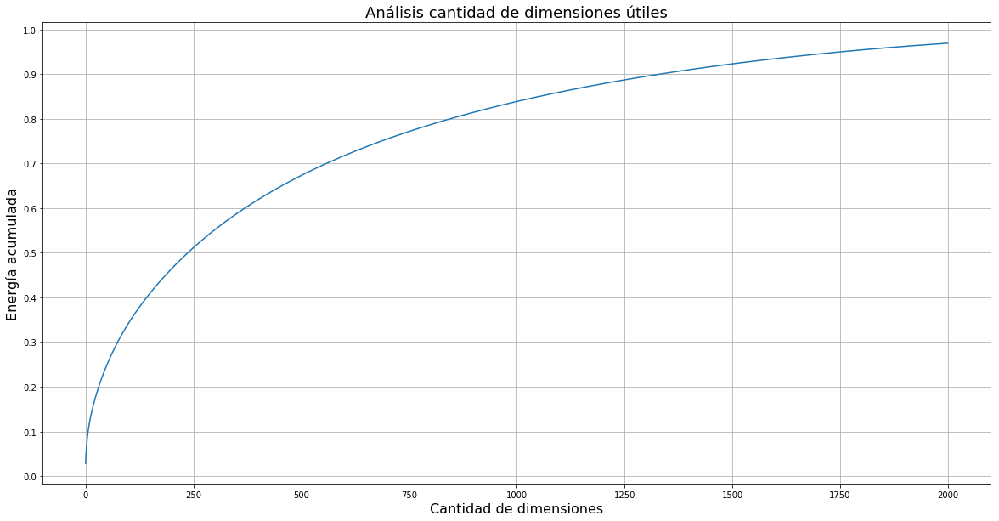

In [52]:
plt.figure(figsize=(20,10)) 

#plt.semilogy(svd.explained_variance_ratio_.cumsum(), '--o')
plt.grid(b=True, which='major')
plt.plot(svd.explained_variance_ratio_.cumsum())
plt.xlabel("Cantidad de dimensiones", fontsize=16)
plt.ylabel("Energía acumulada", fontsize=16)
plt.title("Análisis cantidad de dimensiones útiles", fontsize=18)
plt.yticks(np.arange(0,1.1,0.1))
plt.show()

In [ ]:
param_grid= {'max_features': [None], 'max_depth': [500], 'min_samples_leaf': [1],
             'class_weight': ['balanced']}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(hstack([X_train_svd, X_train]), y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

In [ ]:
param_grid= {'max_features': [10, 20, 50, 'auto', 1000, 2000, None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1, 2, 10],
             'class_weight': ['balanced']}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

T-SNE

In [207]:
tsne = TSNE(n_components=2, n_jobs=-1, perplexity=30.0)
tsne.get_params()

{'angle': 0.5,
 'early_exaggeration': 12.0,
 'init': 'random',
 'learning_rate': 200.0,
 'method': 'barnes_hut',
 'metric': 'euclidean',
 'min_grad_norm': 1e-07,
 'n_components': 2,
 'n_iter': 1000,
 'n_iter_without_progress': 300,
 'n_jobs': -1,
 'perplexity': 30.0,
 'random_state': None,
 'verbose': 0}

In [53]:
colors = []
for place in y_train:
    colors.append(class_names_hashtags.index(place))

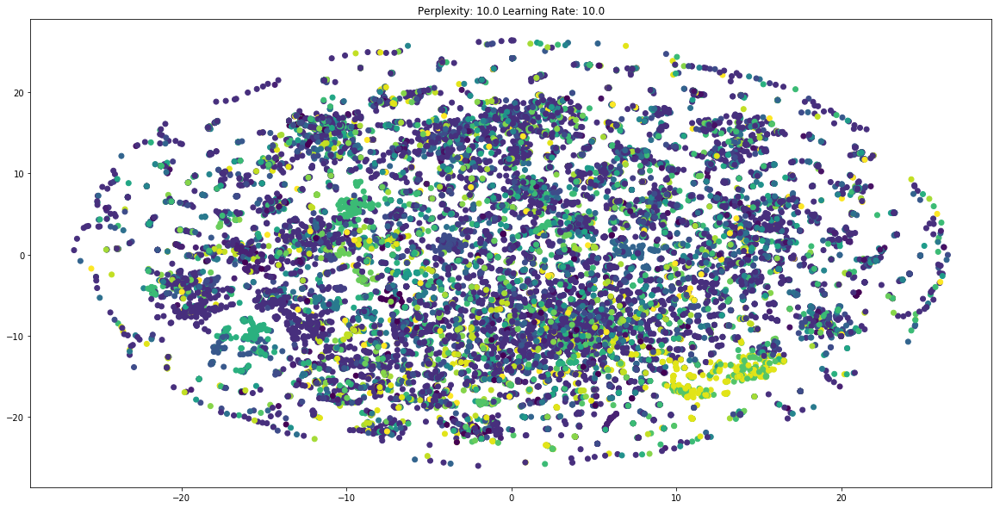

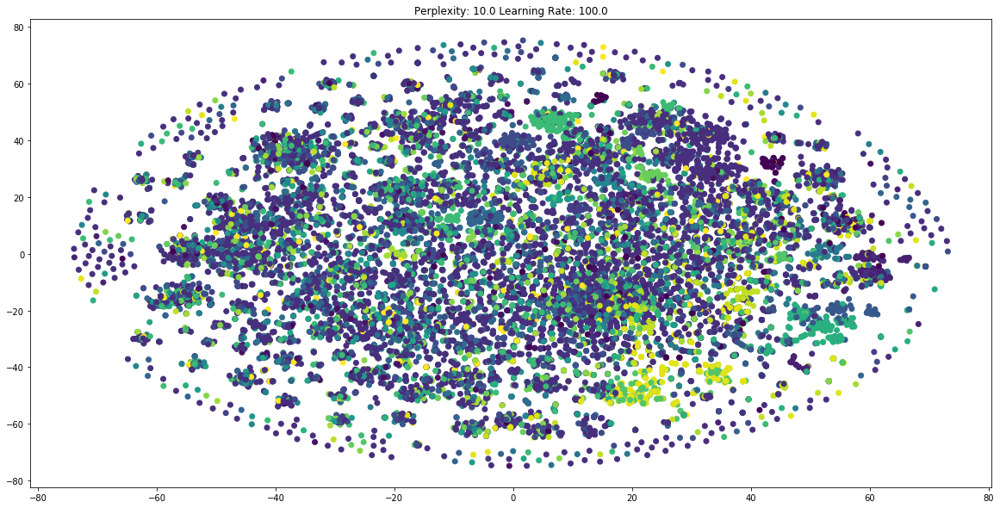

KeyboardInterrupt: 

In [54]:
perplexity_values = [10.0, 30.0, 50.0, 100.0]
learning_rate_values = [10.0, 100.0, 200.0, 500.0, 1000.0]

for perplexity in perplexity_values:
    for learning_rate in learning_rate_values:
        tsne = TSNE(n_components=2, n_jobs=5, perplexity=perplexity, learning_rate=learning_rate)
        X_train_tsne = tsne.fit_transform(X_train_svd)

        plt.figure(figsize=(20,10)) 

        #plt.grid(b=True, which='major')
        plt.scatter(X_train_tsne[:, 0], X_train_tsne[:, 1], c=colors)
        plt.title("Perplexity: " + str(perplexity) + " Learning Rate: " + str(learning_rate))
        plt.show()

# Hashtags - generando muestras aleatorias

In [48]:
X_train, X_test, y_train, y_test = train_test_split(vector, users_complete_location_hashtags[:,0], test_size=0.30)

In [49]:
samples = dict(pd.DataFrame({'r':y_train})['r'].value_counts())
samples

{'asuncion,paraguay': 428,
 'avellaneda,argentina': 410,
 'caracas,venezuela': 372,
 'ciudad autónoma de buenos aires,argentina': 8730,
 'corrientes,argentina': 423,
 'córdoba,argentina': 1856,
 'guayaquil,ecuador': 460,
 'la plata,argentina': 1171,
 'lomas de zamora,argentina': 536,
 'madrid,españa': 342,
 'mar del plata,argentina': 790,
 'morón,argentina': 379,
 'posadas,argentina': 398,
 'quilmes,argentina': 469,
 'quito,ecuador': 646,
 'rosario,argentina': 1496,
 'río de janeiro,brasil': 355,
 'salta,argentina': 441,
 'san isidro,argentina': 417,
 'san miguel de tucumán,argentina': 497,
 'santiago,chile': 498,
 'sao paulo,brasil': 528,
 'tigre,argentina': 403}

In [50]:
(values,counts) = np.unique(y_train,return_counts=True)
ind=np.argmax(counts)
mayority_sample_city = values[ind]
mayority_samples = counts[ind]

In [51]:
smote_undersample_dict = samples.copy()
smote_undersample_dict[mayority_sample_city] = int(mayority_samples * 0.8)
smote_undersample_dict

{'asuncion,paraguay': 428,
 'avellaneda,argentina': 410,
 'caracas,venezuela': 372,
 'ciudad autónoma de buenos aires,argentina': 6984,
 'corrientes,argentina': 423,
 'córdoba,argentina': 1856,
 'guayaquil,ecuador': 460,
 'la plata,argentina': 1171,
 'lomas de zamora,argentina': 536,
 'madrid,españa': 342,
 'mar del plata,argentina': 790,
 'morón,argentina': 379,
 'posadas,argentina': 398,
 'quilmes,argentina': 469,
 'quito,ecuador': 646,
 'rosario,argentina': 1496,
 'río de janeiro,brasil': 355,
 'salta,argentina': 441,
 'san isidro,argentina': 417,
 'san miguel de tucumán,argentina': 497,
 'santiago,chile': 498,
 'sao paulo,brasil': 528,
 'tigre,argentina': 403}

In [52]:
undersample = RandomUnderSampler(sampling_strategy=smote_undersample_dict)
X_train, y_train = undersample.fit_resample(X_train, y_train)

In [53]:
(values,counts) = np.unique(y_train,return_counts=True)
ind=np.argmax(counts)
mayority_sample_city = values[ind]
mayority_samples = counts[ind]
print(mayority_sample_city, mayority_samples)

ciudad autónoma de buenos aires,argentina 6984


In [54]:
smote_oversample_dict = dict(map(lambda x: [x[1], int(mayority_samples * 1.0)], np.ndenumerate(y_train)))

In [55]:
del smote_oversample_dict[mayority_sample_city]

In [56]:
smote_oversample_dict

{'asuncion,paraguay': 6984,
 'avellaneda,argentina': 6984,
 'caracas,venezuela': 6984,
 'corrientes,argentina': 6984,
 'córdoba,argentina': 6984,
 'guayaquil,ecuador': 6984,
 'la plata,argentina': 6984,
 'lomas de zamora,argentina': 6984,
 'madrid,españa': 6984,
 'mar del plata,argentina': 6984,
 'morón,argentina': 6984,
 'posadas,argentina': 6984,
 'quilmes,argentina': 6984,
 'quito,ecuador': 6984,
 'rosario,argentina': 6984,
 'río de janeiro,brasil': 6984,
 'salta,argentina': 6984,
 'san isidro,argentina': 6984,
 'san miguel de tucumán,argentina': 6984,
 'santiago,chile': 6984,
 'sao paulo,brasil': 6984,
 'tigre,argentina': 6984}

In [57]:
oversample = SMOTE(sampling_strategy=smote_oversample_dict)
X_train, y_train = oversample.fit_resample(X_train, y_train)

In [58]:
pd.DataFrame({'r':y_train})['r'].value_counts()

avellaneda,argentina                         6984
la plata,argentina                           6984
san isidro,argentina                         6984
rosario,argentina                            6984
corrientes,argentina                         6984
tigre,argentina                              6984
posadas,argentina                            6984
río de janeiro,brasil                        6984
mar del plata,argentina                      6984
lomas de zamora,argentina                    6984
sao paulo,brasil                             6984
santiago,chile                               6984
quito,ecuador                                6984
guayaquil,ecuador                            6984
córdoba,argentina                            6984
salta,argentina                              6984
madrid,españa                                6984
caracas,venezuela                            6984
asuncion,paraguay                            6984
san miguel de tucumán,argentina              6984


DecisionTree

In [101]:
decisiontree = DecisionTreeClassifier()
decisiontree.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [102]:
param_grid= {'max_features': [10, 20, 50, 'auto', 1000, 2000,None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1],
             'class_weight': [None]}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)#y_train[:, 0])
print(grid_drop.best_params_, grid_drop.best_score_)

{'class_weight': None, 'max_depth': None, 'min_samples_leaf': 1, 'max_features': 10} 0.8850304067110721


In [103]:
y_predicted = grid_drop.predict(X_test)

In [104]:
accuracy_score(y_test, y_predicted)

0.27508467400508047

In [105]:
balanced_accuracy_score(y_test, y_predicted)

0.20397014346157763

In [106]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


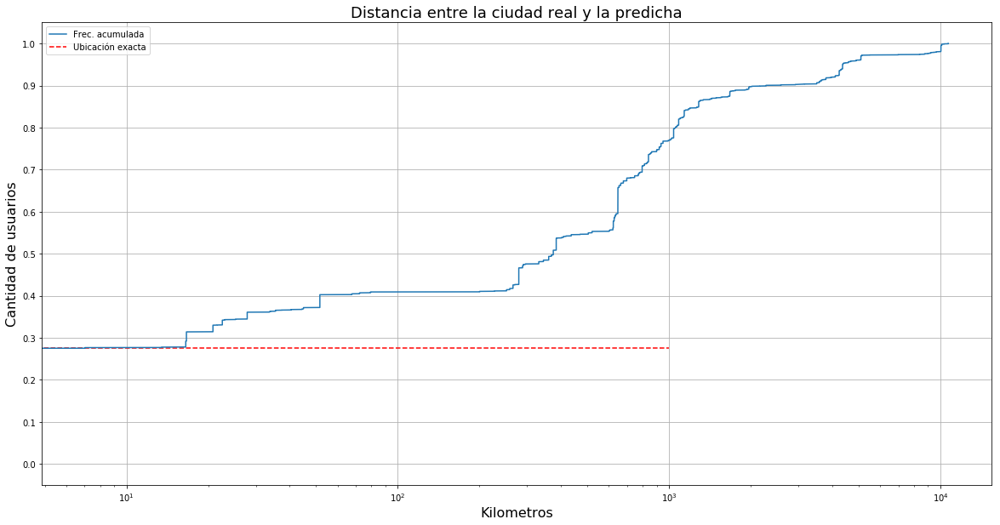

In [107]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

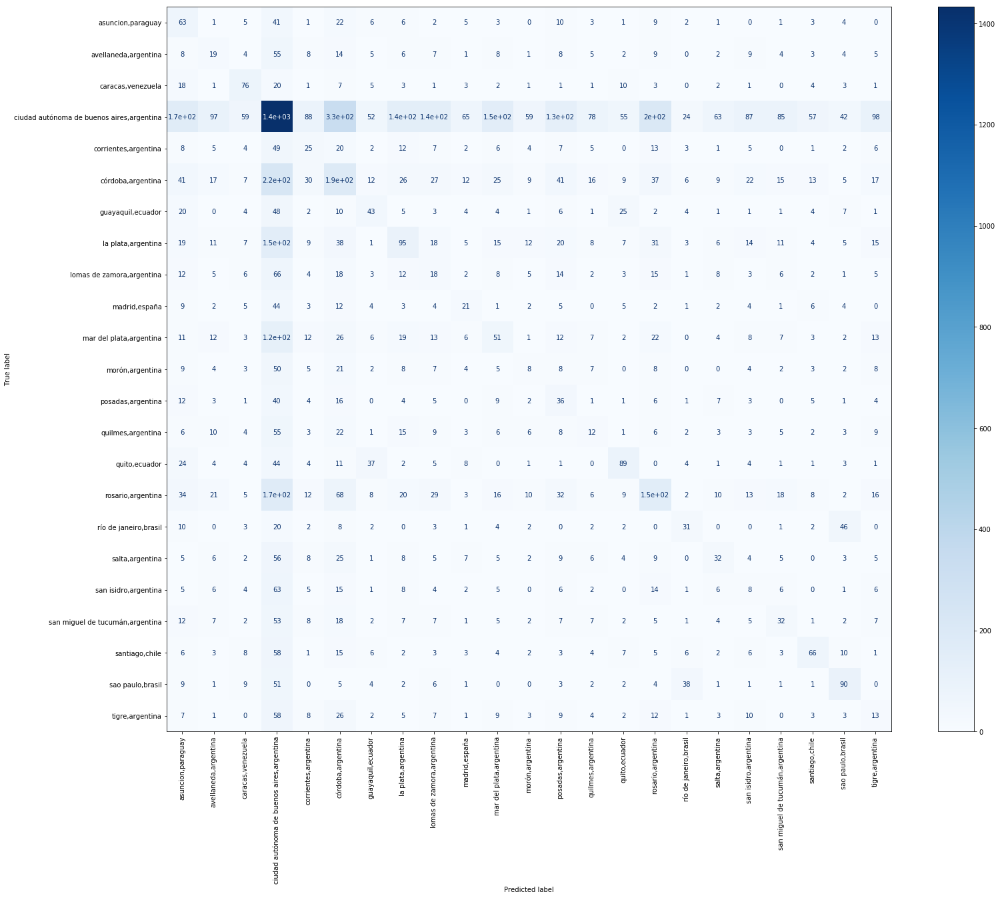

In [108]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_hashtags,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

RandomForest

In [80]:
randomforest = RandomForestClassifier()
randomforest.get_params()

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': None,
 'verbose': 0,
 'warm_start': False}

In [105]:
param_grid= {'min_samples_leaf': [1], 'class_weight': [None], 'max_depth': [None],
             'max_features': [10], 'n_jobs': [5]}
grid_drop = GridSearchCV(randomforest, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

{'n_jobs': 5, 'max_depth': None, 'class_weight': None, 'min_samples_leaf': 1, 'max_features': 10} 0.8922092984376999


In [106]:
y_predicted = grid_drop.predict(X_test)

In [107]:
accuracy_score(y_test, y_predicted)

0.37150719729043186

In [108]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


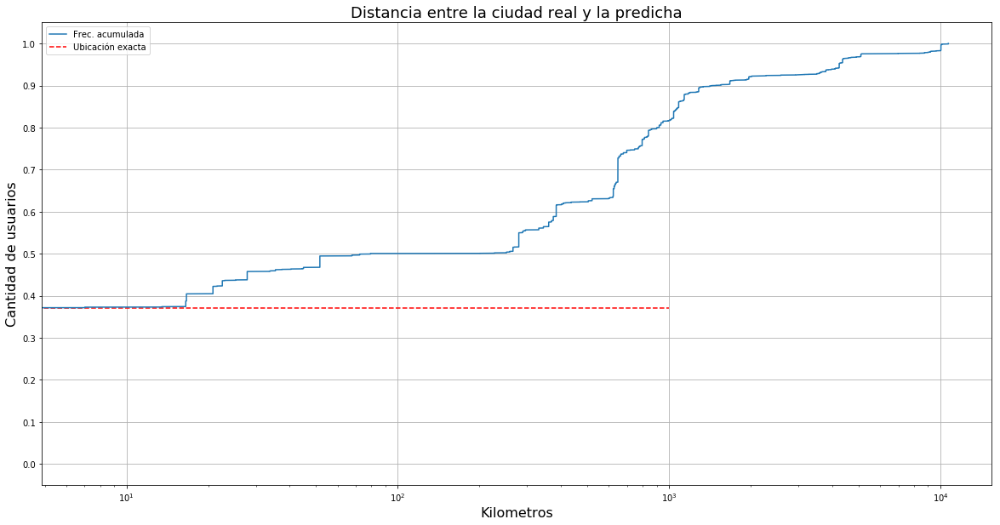

In [109]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

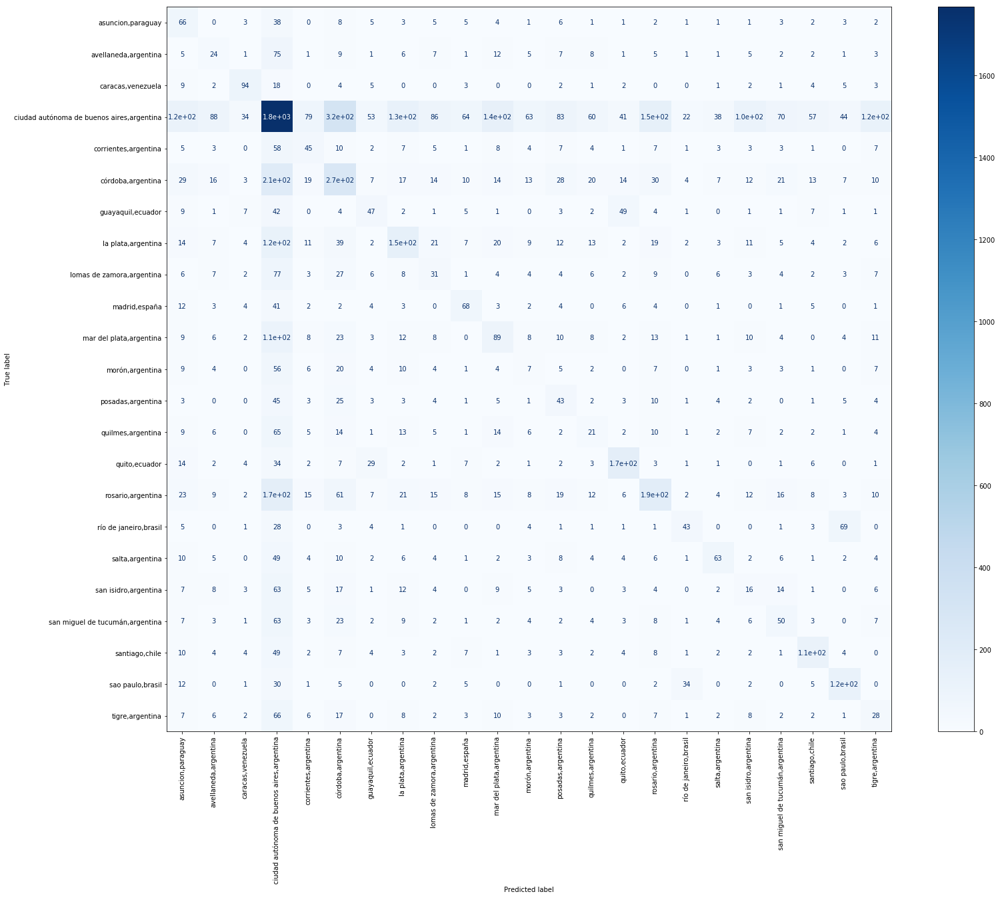

In [110]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_hashtags,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

SVM

In [59]:
scaler = MaxAbsScaler().fit(X_train)
X_train = scaler.transform(X_train)

In [60]:
svc = SVC()
svc.get_params()

{'C': 1.0,
 'break_ties': False,
 'cache_size': 200,
 'class_weight': None,
 'coef0': 0.0,
 'decision_function_shape': 'ovr',
 'degree': 3,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'probability': False,
 'random_state': None,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [61]:
param_grid= {'class_weight': [None], 'cache_size': [2000.0]}

grid_drop = GridSearchCV(svc, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

{'class_weight': None, 'cache_size': 2000.0} 0.866826477423329


In [62]:
y_predicted = grid_drop.predict(X_test)

In [63]:
accuracy_score(y_test, y_predicted)

0.38918289585097376

In [64]:
balanced_accuracy_score(y_test, y_predicted)

0.24823046080658423

In [65]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


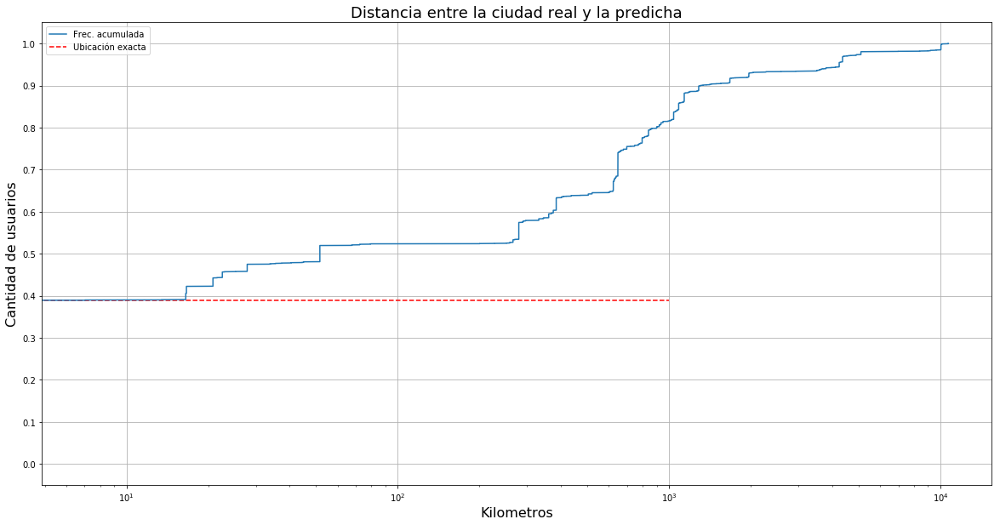

In [66]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

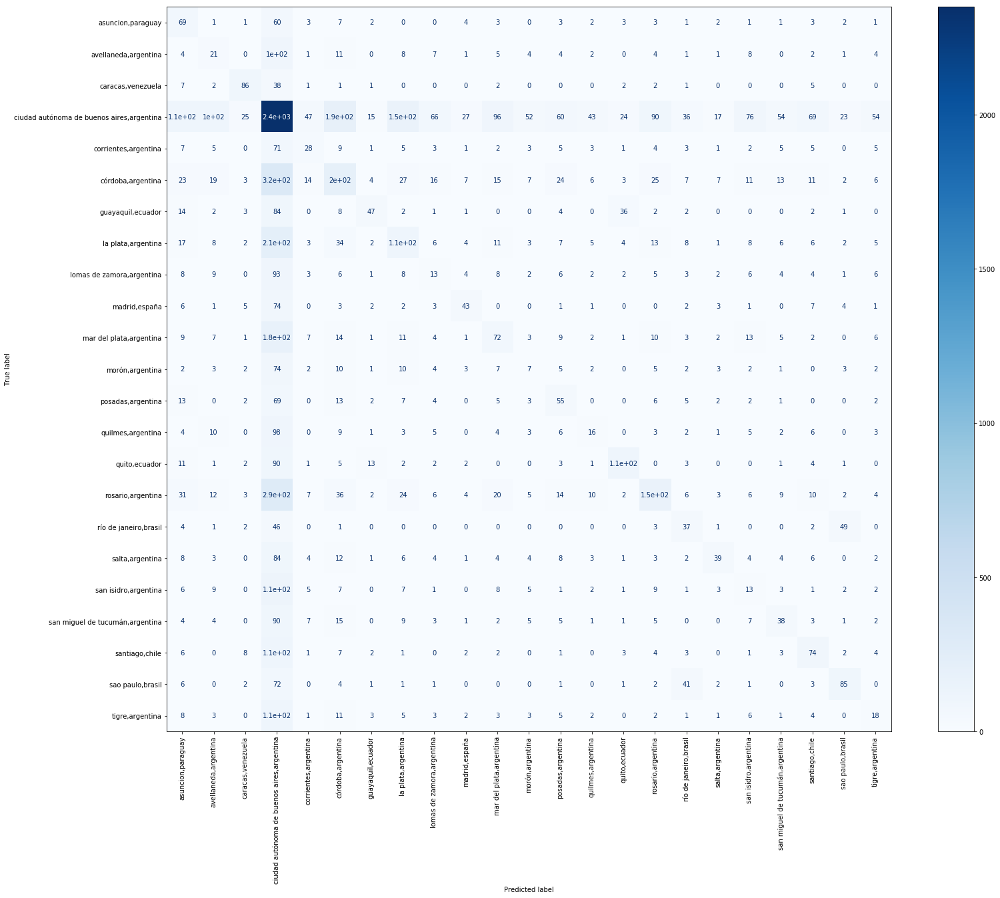

In [67]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_hashtags,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

# Predicción usando solo menciones

In [37]:
vectorizer = CountVectorizer(
    strip_accents="ascii",
    lowercase=True,
)

vector_of_mentions = vectorizer.fit_transform(users_train_only_mentions["users_mentioned"].apply(lambda x: ' '.join(x))).astype('bool')
vector_of_mentions

<46090x91941 sparse matrix of type '<class 'numpy.bool_'>'
	with 800644 stored elements in Compressed Sparse Row format>

In [38]:
mentions_list = vectorizer.get_feature_names()

# Menciones sin generar muestras

In [70]:
X_train, X_test, y_train, y_test = train_test_split(vector_of_mentions, users_complete_location_mentions[:,0], test_size=0.30)

In [53]:
decisiontree = DecisionTreeClassifier()
decisiontree.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [59]:
param_grid= {'max_features': [10, 20, 50, 'auto', 1000, 2000,None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1],
             'class_weight': ['balanced']}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)#y_train[:, 0])
print(grid_drop.best_params_, grid_drop.best_score_)

{'min_samples_leaf': 1, 'max_features': None, 'class_weight': 'balanced', 'max_depth': 200} 0.5256176306161131


In [ ]:
y_predicted = grid_drop.predict(X_test)

In [ ]:
accuracy_score(y_test, y_predicted)

In [62]:
balanced_accuracy_score(y_test, y_predicted)

0.2978993087106296

In [63]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


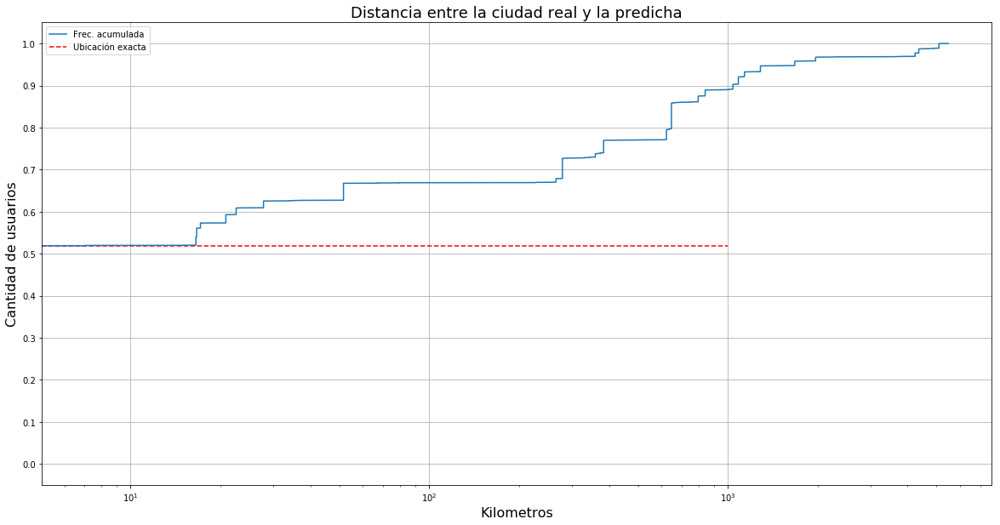

In [64]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

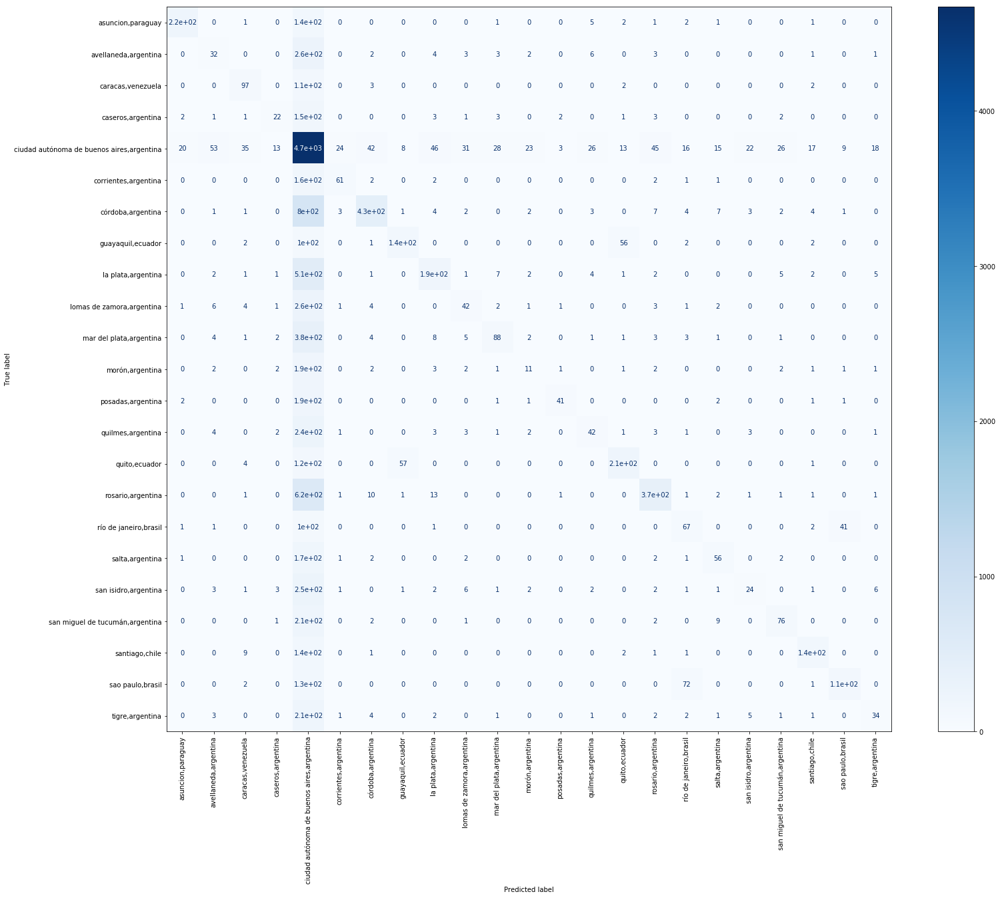

In [65]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_mentions,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

SVD

In [71]:
scaler = MaxAbsScaler().fit(vector_of_mentions)
vector_of_mentions = scaler.transform(vector_of_mentions)

Generando nodos para software graficador

In [39]:
cx = vector_of_mentions.tocoo()
edges = []
for i,j,v in zip(cx.row, cx.col, cx.data):
    format_str = str(i) + " " + str(j)
    edges.append(format_str)

In [40]:
len(edges)

800644

In [41]:
df = pd.DataFrame({"edges": edges})

In [42]:
df.to_csv("../edges.csv", header=False, index=False)

In [53]:
df.to_csv("../../../../dosT/ffunes/edges.csv", header=False, index=False)

In [54]:
df2 = pd.DataFrame({"city": users_complete_location_mentions[:,0]})

In [55]:
vector_of_mentions.shape

(46090, 91941)

In [57]:
l = ["-"] * (vector_of_mentions.shape[1] - vector_of_mentions.shape[0])
df_aux = pd.DataFrame({"city": l})
df2 = pd.concat([df2, df_aux])

In [58]:
df2 = df2.reset_index(drop=True)

In [61]:
default_colors = [
    "1 0 0",
    "0 1 0",
    "0 0 1",
    "1 1 0",
    "0 1 1",
    "1 0 1",
    "0.75 0 0.25",
    "0.75 0.25 0",
    "0.25 0 0.75",
    "0 0.25 0.75",
    "0 0.75 0.25",
    "0.25 0.75 0.5",
    "0.5 0.25 0.75",
    "0.5 1.0 0.25",
    "1.0 0.5 0.25",
    "0.75 0.75 1.0",
    "0.3 0.3 0.9",
    "0.9 0.3 0.3",
    "0.3 0.9 0.9",
    "0.4 0.2 0.8",
    "0.4 0.8 0.2",
    "0.8 0 0.4",
    "0.8 0.5 1.0",
    "0.5 0.5 0.5"
]
colors = {}
i = 0
for place in class_names_mentions:
    colors[place] = default_colors[i]
    i += 1
    
colors['-'] = default_colors[i]

In [62]:
df2["color"] = df2["city"].apply(lambda x: colors[x])

In [63]:
df2 = df2.loc[:, ["color"]]
df2["color"] = df2.reset_index()["index"].astype(str) + " " + df2["color"]

In [64]:
df2.to_csv("../../../../dosT/ffunes/nodes_color.csv", header=False, index=False)

Intentemos armar una matriz de co-menciones

In [65]:
vector_of_co_mentions = vector_of_mentions.dot(vector_of_mentions.T)
vector_of_co_mentions.setdiag(0, k=0)

In [68]:
svd = TruncatedSVD(n_components=8000)

In [ ]:
X_train_svd = svd.fit_transform(X_train)

In [ ]:
svd.explained_variance_ratio_.cumsum()[-1]

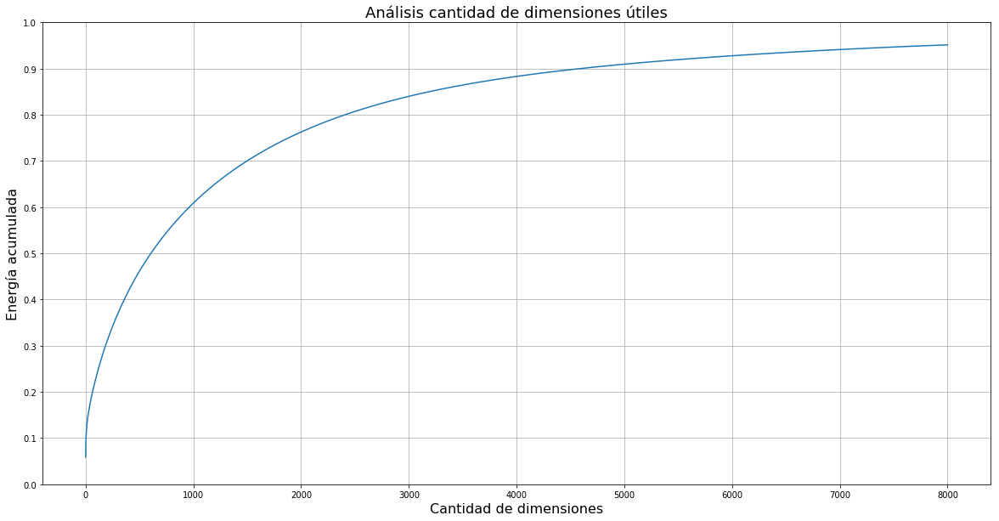

In [46]:
plt.figure(figsize=(20,10)) 

#plt.semilogy(svd.explained_variance_ratio_.cumsum(), '--o')
plt.grid(b=True, which='major')
plt.plot(svd.explained_variance_ratio_.cumsum())
plt.xlabel("Cantidad de dimensiones", fontsize=16)
plt.ylabel("Energía acumulada", fontsize=16)
plt.title("Análisis cantidad de dimensiones útiles", fontsize=18)
plt.yticks(np.arange(0,1.1,0.1))
plt.show()

In [46]:
svd = TruncatedSVD(n_components=50)

In [47]:
X_train_svd = svd.fit_transform(X_train)

In [48]:
svd.explained_variance_ratio_.cumsum()[-1]

0.18284362470536278

T-SNE

In [49]:
tsne = TSNE(n_components=2, n_jobs=-1, perplexity=30.0)
tsne.get_params()

{'angle': 0.5,
 'early_exaggeration': 12.0,
 'init': 'random',
 'learning_rate': 200.0,
 'method': 'barnes_hut',
 'metric': 'euclidean',
 'min_grad_norm': 1e-07,
 'n_components': 2,
 'n_iter': 1000,
 'n_iter_without_progress': 300,
 'n_jobs': -1,
 'perplexity': 30.0,
 'random_state': None,
 'verbose': 0}

In [64]:
colors = []
for place in y_train:
    colors.append(class_names_mentions.index(place))

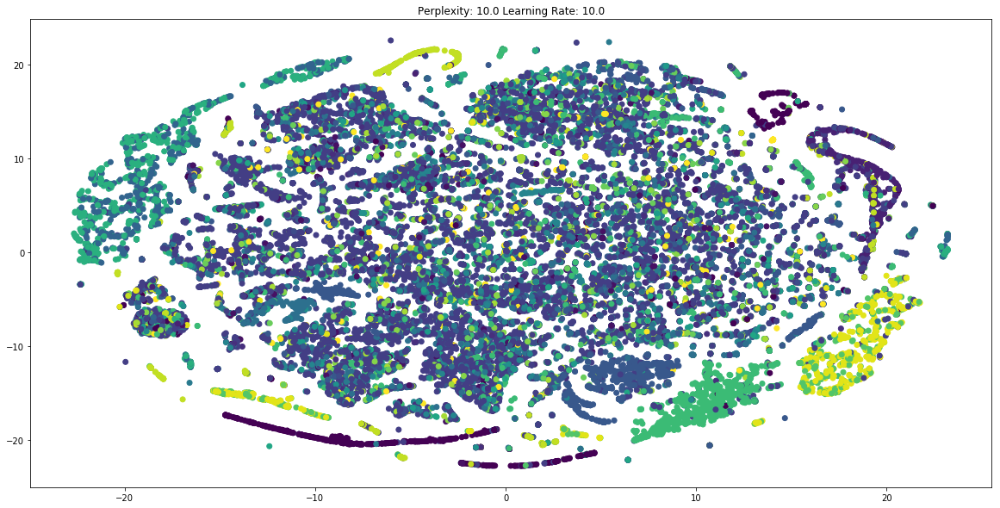

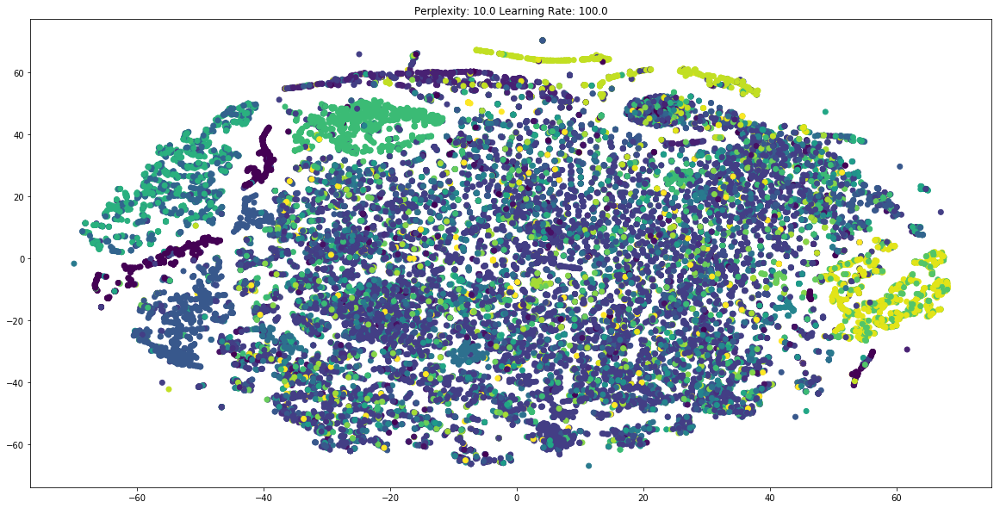

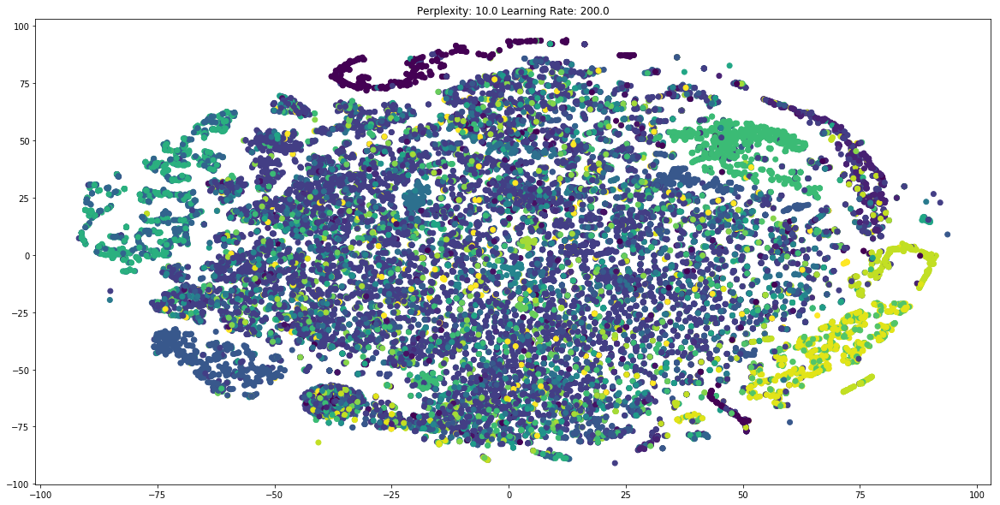

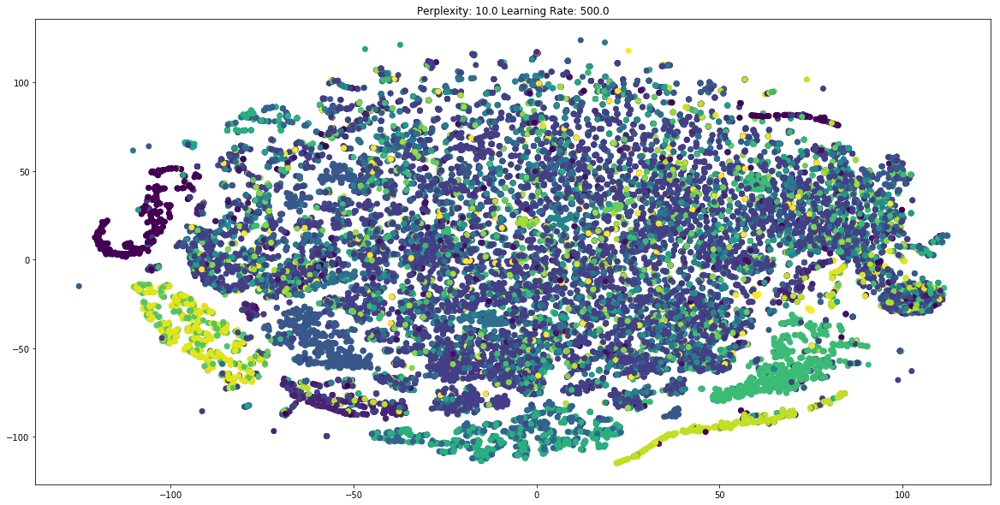

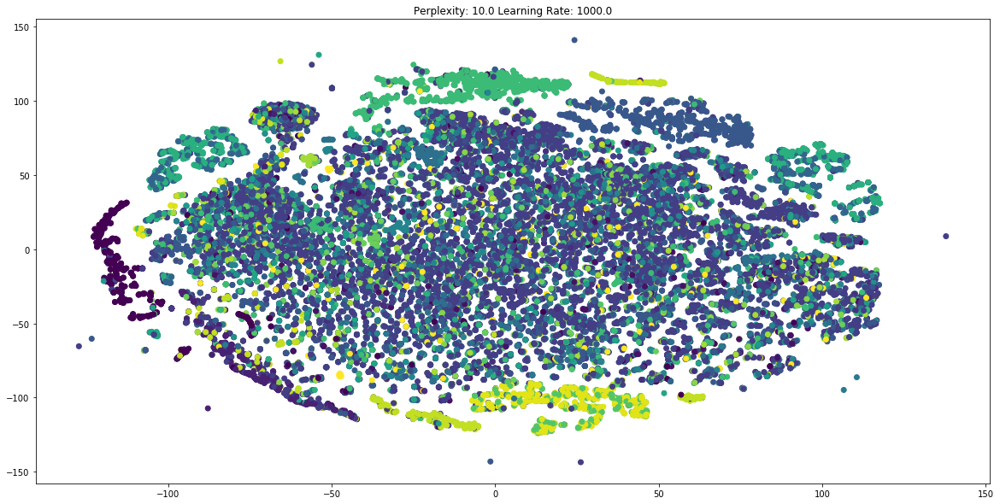

...

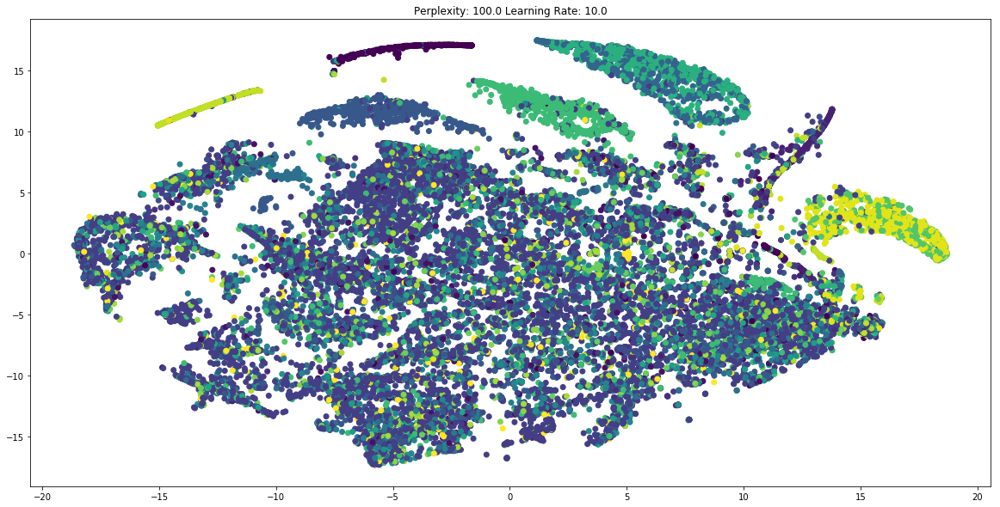

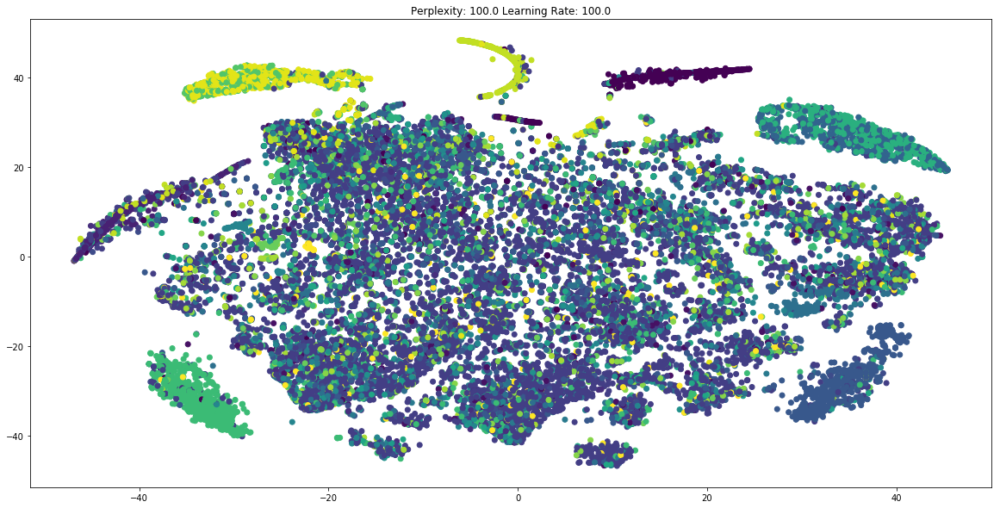

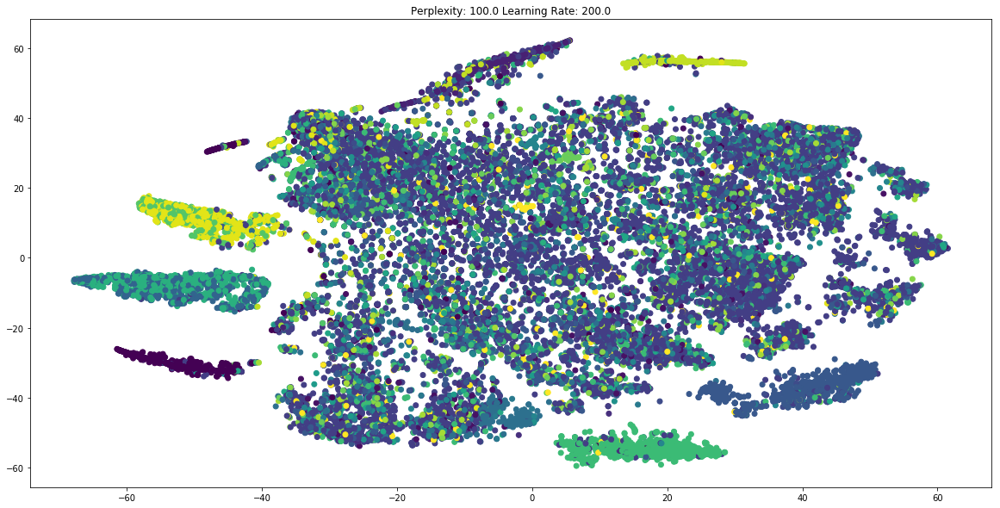

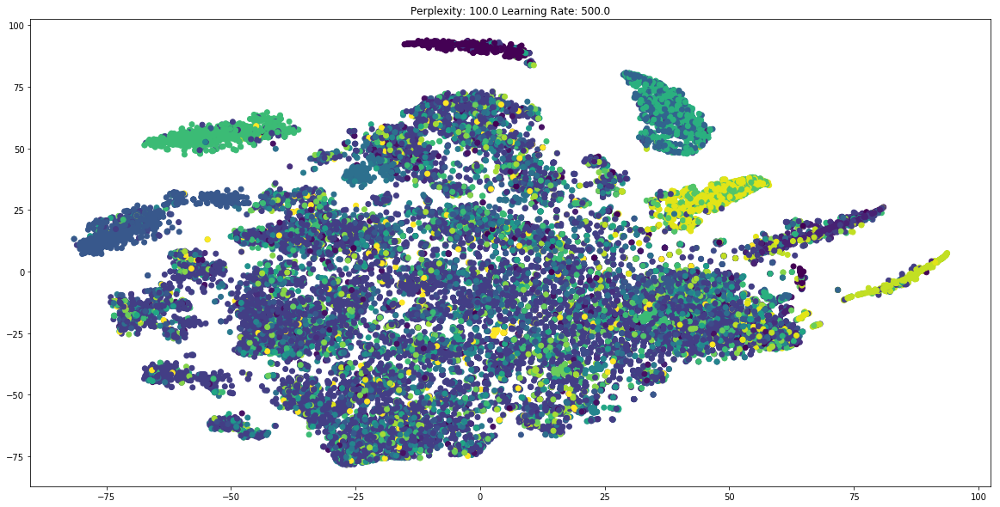

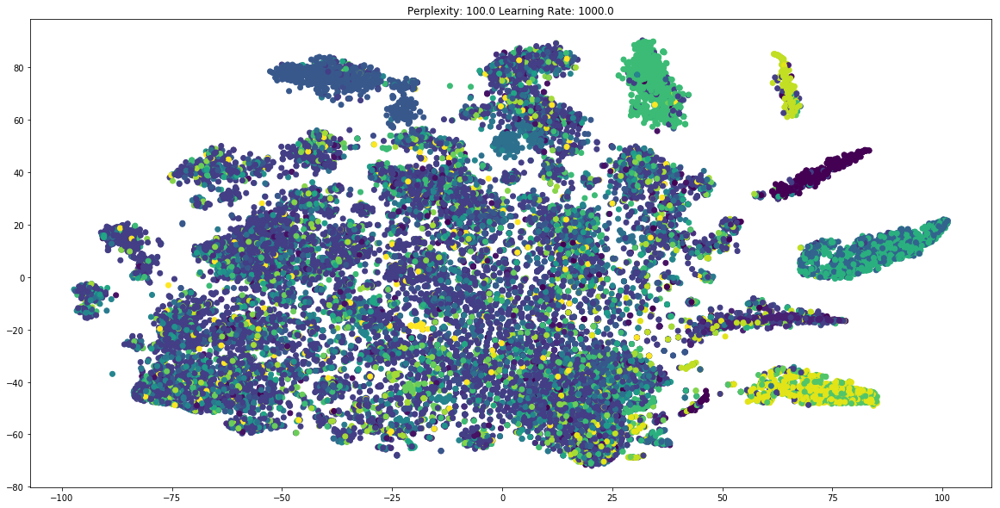

In [51]:
perplexity_values = [10.0, 30.0, 50.0, 100.0]
learning_rate_values = [10.0, 100.0, 200.0, 500.0, 1000.0]

for perplexity in perplexity_values:
    for learning_rate in learning_rate_values:
        tsne = TSNE(n_components=2, n_jobs=5, perplexity=perplexity, learning_rate=learning_rate)
        X_train_tsne = tsne.fit_transform(X_train_svd)

        plt.figure(figsize=(20,10)) 

        #plt.grid(b=True, which='major')
        plt.scatter(X_train_tsne[:, 0], X_train_tsne[:, 1], c=colors)
        plt.title("Perplexity: " + str(perplexity) + " Learning Rate: " + str(learning_rate))
        plt.show()

In [ ]:
#tsne = TSNE(n_components=2, n_jobs=5, perplexity=100.0, learning_rate=1000.0)
#X_train_tsne = tsne.fit_transform(X_train_svd)
import matplotlib.patches as mpatches
plt.figure(figsize=(20,10)) 

#plt.grid(b=True, which='major')
a = plt.scatter(X_train_tsne[:, 0], X_train_tsne[:, 1], c=colors)
plt.title("Perplexity: " + str(perplexity) + " Learning Rate: " + str(learning_rate))

from matplotlib.font_manager import FontProperties

fontP = FontProperties()
fontP.set_size('small')

recs = []
for i in range(0,len(class_names_hashtags)):
    recs.append(mpatches.Rectangle((0,0),1,1, color=colors[i]))
plt.legend(recs,class_names_hashtags,loc='best', prop=fontP)

plt.show()

Node2vec

In [93]:
!cd ../snap/examples/node2vec && \
./node2vec -i:../../../edges.csv -o:../../../edges_node2vec.emb -d:32 -p:0.25 -q:0.25 -l:5 -r:10 -dr


An algorithmic framework for representational learning on graphs. [Apr 21 2020]
Input graph path (-i:)=../../../edges.csv
Output graph path (-o:)=../../../edges_node2vec.emb
Number of dimensions. Default is 128 (-d:)=32
Length of walk per source. Default is 80 (-l:)=5
Number of walks per source. Default is 10 (-r:)=10
Context size for optimization. Default is 10 (-k:)=10
Number of epochs in SGD. Default is 1 (-e:)=1
Return hyperparameter. Default is 1 (-p:)=0.25
Inout hyperparameter. Default is 1 (-q:)=0.25
Verbose output. (-v)=NO
Graph is directed. (-dr)=YES
Graph is weighted. (-w)=NO
Output random walks instead of embeddings. (-ow)=NO


In [94]:
vector_of_mentions_node2vec = pd.read_csv("../edges_node2vec.emb", header=None, skiprows=1, sep=" ")
vector_of_mentions_node2vec.drop(range(vector_of_mentions.shape[0], vector_of_mentions.shape[1]), inplace=True)
vector_of_mentions_node2vec.drop(0, axis=1, inplace=True)

In [95]:
vector_of_mentions_node2vec.shape

(46090, 32)

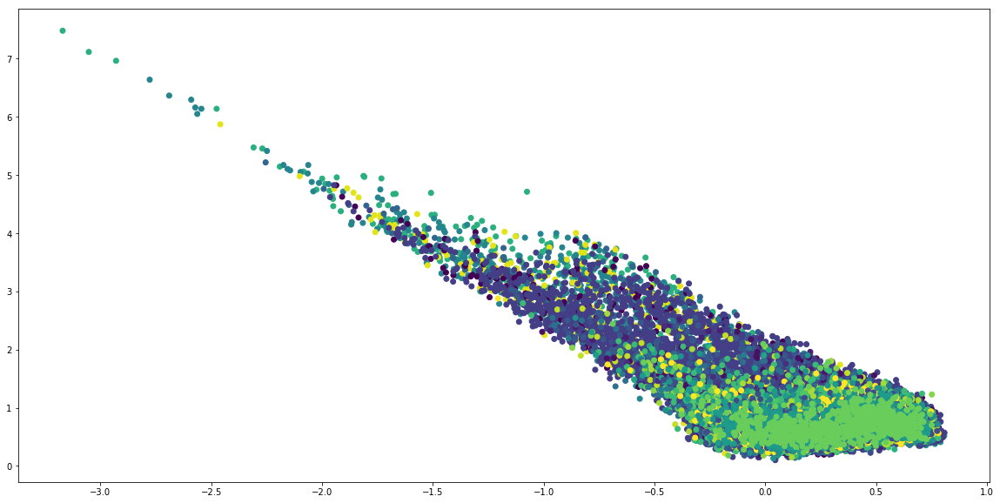

In [92]:
plt.figure(figsize=(20,10)) 

plt.scatter(vector_of_mentions_node2vec.values[:, 0], vector_of_mentions_node2vec.values[:, 1], c=colors)
plt.show()

In [49]:
colors = []
for place in users_complete_location_mentions[:,0]:
    colors.append(class_names_mentions.index(place))

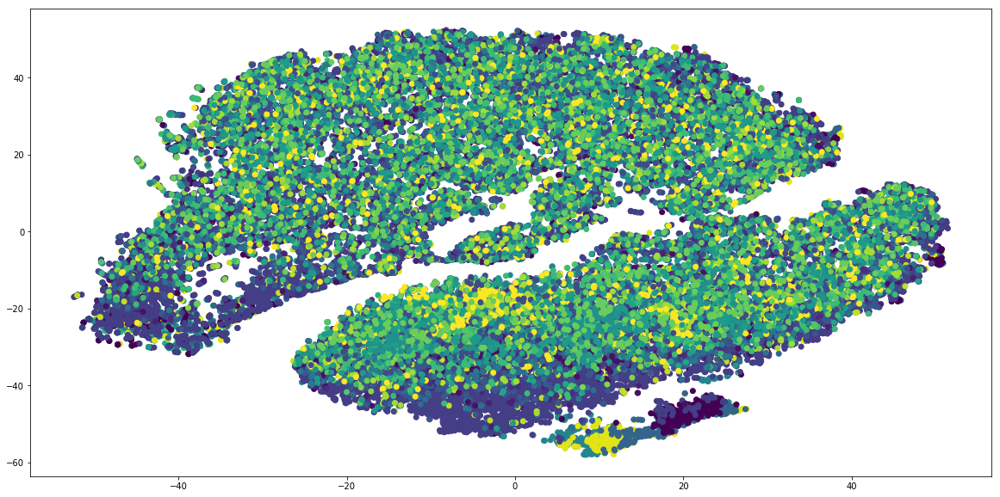

In [96]:
tsne = TSNE(n_components=2, n_jobs=5, perplexity=30, learning_rate=200.0)
X_train_tsne = tsne.fit_transform(vector_of_mentions_node2vec)

plt.figure(figsize=(20,10)) 

plt.scatter(X_train_tsne[:, 0], X_train_tsne[:, 1], c=colors)
plt.show()

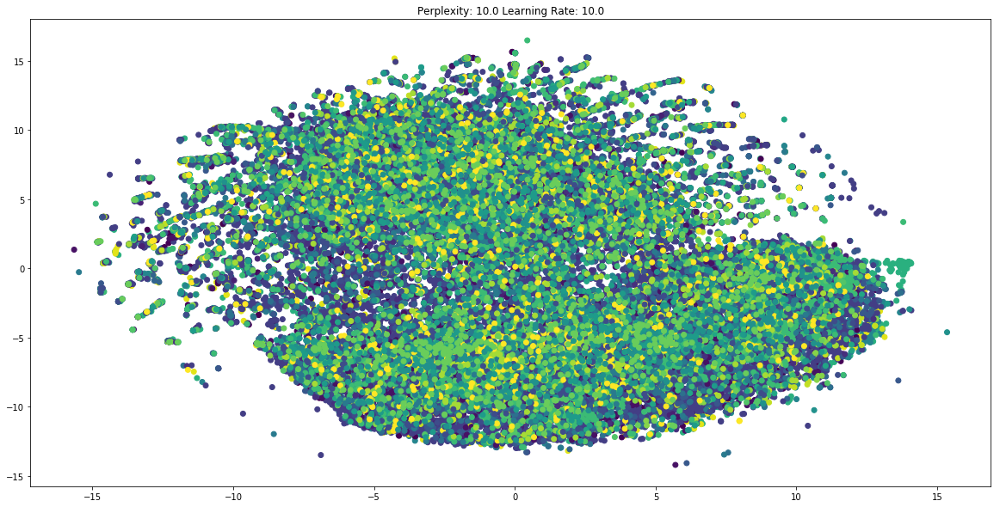

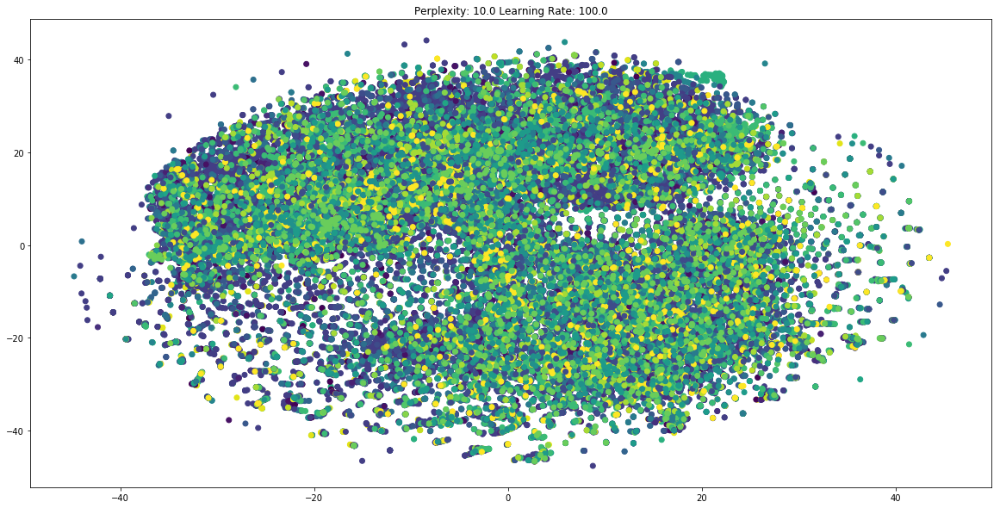

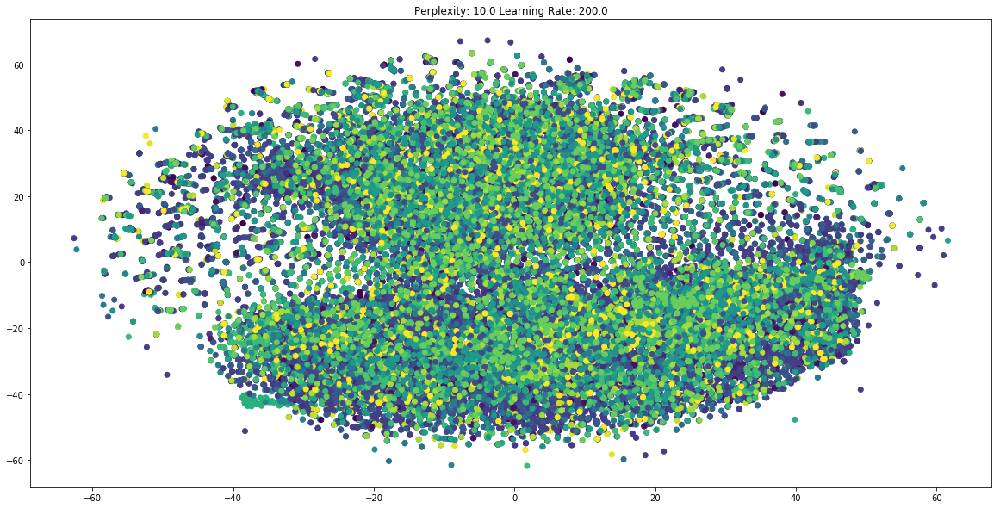

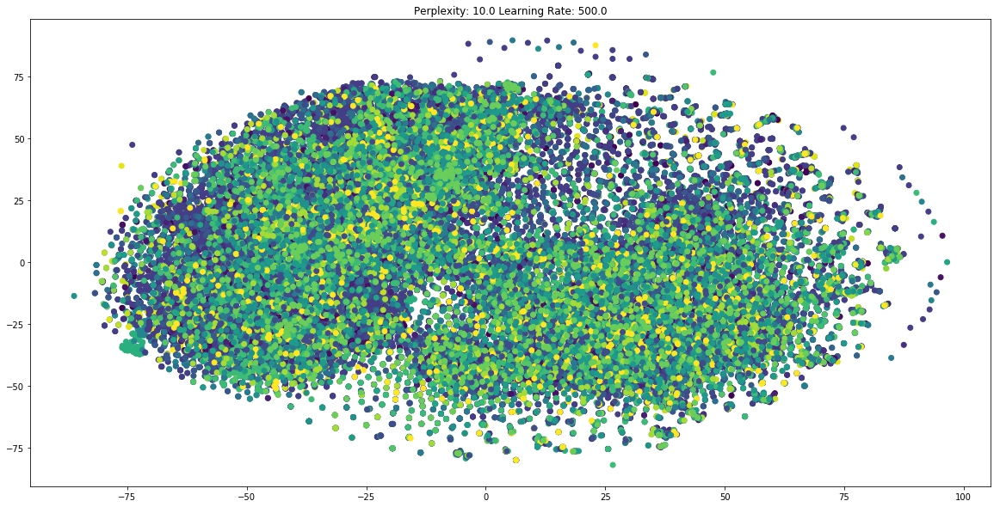

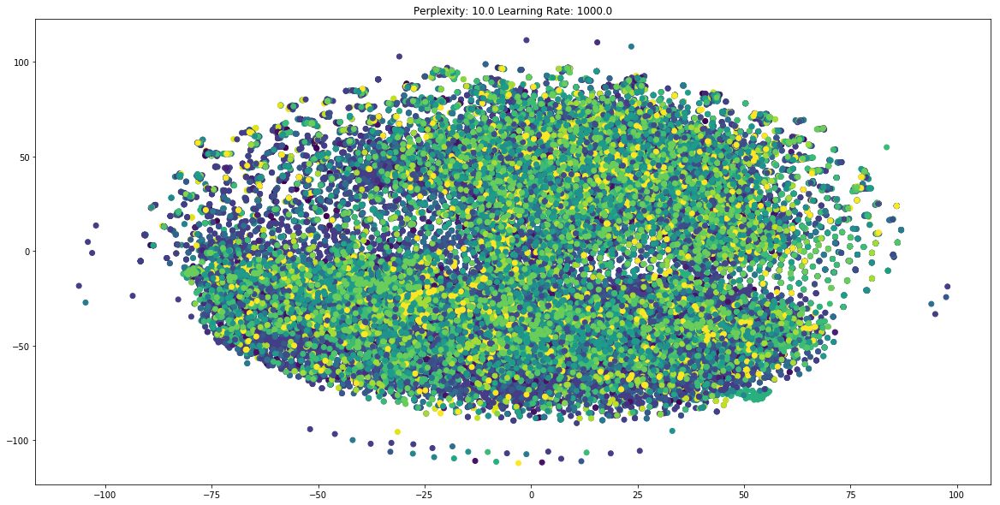

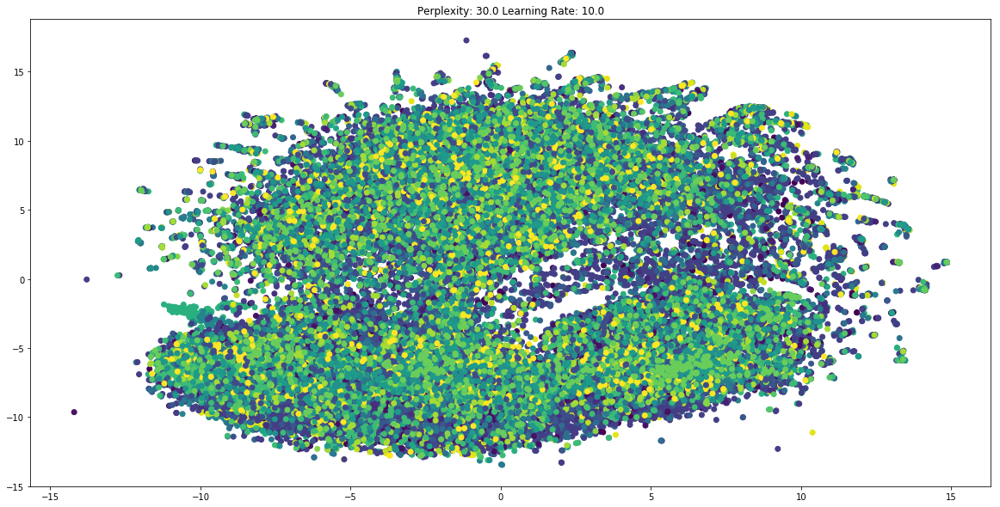

In [ ]:
perplexity_values = [10.0, 30.0, 50.0, 100.0]
learning_rate_values = [10.0, 100.0, 200.0, 500.0, 1000.0]

for perplexity in perplexity_values:
    for learning_rate in learning_rate_values:
        tsne = TSNE(n_components=2, n_jobs=5, perplexity=perplexity, learning_rate=learning_rate)
        X_train_tsne = tsne.fit_transform(vector_of_mentions_node2vec)

        plt.figure(figsize=(20,10)) 

        #plt.grid(b=True, which='major')
        plt.scatter(X_train_tsne[:, 0], X_train_tsne[:, 1], c=colors)
        plt.title("Perplexity: " + str(perplexity) + " Learning Rate: " + str(learning_rate))
        plt.show()

In [52]:
X_train, X_test, y_train, y_test = train_test_split(vector_of_mentions_node2vec, users_complete_location_mentions[:,0], test_size=0.30)

In [43]:
decisiontree = DecisionTreeClassifier()
decisiontree.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [44]:
param_grid= {'max_features': [10, 20, 50, 'auto', None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1],
             'class_weight': ['balanced']}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)#y_train[:, 0])
print(grid_drop.best_params_, grid_drop.best_score_)

{'min_samples_leaf': 1, 'max_features': 10, 'class_weight': 'balanced', 'max_depth': 200} 0.17819175402396975


In [45]:
y_predicted = grid_drop.predict(X_test)

In [46]:
accuracy_score(y_test, y_predicted)

0.17306718738699645

In [47]:
balanced_accuracy_score(y_test, y_predicted)

0.06407783684520149

In [53]:
X_train_scaled = scale(X_train)

In [59]:
svc = SVC()
svc.get_params()

{'C': 1.0,
 'break_ties': False,
 'cache_size': 200,
 'class_weight': None,
 'coef0': 0.0,
 'decision_function_shape': 'ovr',
 'degree': 3,
 'gamma': 'scale',
 'kernel': 'rbf',
 'max_iter': -1,
 'probability': False,
 'random_state': None,
 'shrinking': True,
 'tol': 0.001,
 'verbose': False}

In [ ]:
param_grid= {'class_weight': ['balanced'], 'cache_size': [2000.0]}

grid_drop = GridSearchCV(svc, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train_scaled, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

Infomap

In [40]:
!cd ../infomap/infomap-1.1.3 && \
./Infomap --clu -d --silent ../../edges.csv ../../

# Menciones generando muestras aleatorias

In [120]:
X_train, X_test, y_train, y_test = train_test_split(vector_of_mentions, users_complete_location_mentions[:,0], test_size=0.30)

In [121]:
samples = dict(pd.DataFrame({'r':y_train})['r'].value_counts())
samples

{'asuncion,paraguay': 956,
 'avellaneda,argentina': 653,
 'caracas,venezuela': 521,
 'caseros,argentina': 494,
 'ciudad autónoma de buenos aires,argentina': 12022,
 'corrientes,argentina': 563,
 'córdoba,argentina': 2868,
 'guayaquil,ecuador': 763,
 'la plata,argentina': 1726,
 'lomas de zamora,argentina': 806,
 'mar del plata,argentina': 1142,
 'morón,argentina': 586,
 'posadas,argentina': 507,
 'quilmes,argentina': 698,
 'quito,ecuador': 990,
 'rosario,argentina': 2330,
 'río de janeiro,brasil': 476,
 'salta,argentina': 527,
 'san isidro,argentina': 723,
 'san miguel de tucumán,argentina': 637,
 'santiago,chile': 641,
 'sao paulo,brasil': 734,
 'tigre,argentina': 634}

In [122]:
(values,counts) = np.unique(y_train,return_counts=True)
ind=np.argmax(counts)
mayority_sample_city = values[ind]
mayority_samples = counts[ind]

In [123]:
smote_undersample_dict = samples.copy()
smote_undersample_dict[mayority_sample_city] = int(mayority_samples * 0.60)
smote_undersample_dict

{'asuncion,paraguay': 956,
 'avellaneda,argentina': 653,
 'caracas,venezuela': 521,
 'caseros,argentina': 494,
 'ciudad autónoma de buenos aires,argentina': 7213,
 'corrientes,argentina': 563,
 'córdoba,argentina': 2868,
 'guayaquil,ecuador': 763,
 'la plata,argentina': 1726,
 'lomas de zamora,argentina': 806,
 'mar del plata,argentina': 1142,
 'morón,argentina': 586,
 'posadas,argentina': 507,
 'quilmes,argentina': 698,
 'quito,ecuador': 990,
 'rosario,argentina': 2330,
 'río de janeiro,brasil': 476,
 'salta,argentina': 527,
 'san isidro,argentina': 723,
 'san miguel de tucumán,argentina': 637,
 'santiago,chile': 641,
 'sao paulo,brasil': 734,
 'tigre,argentina': 634}

In [124]:
undersample = RandomUnderSampler(sampling_strategy=smote_undersample_dict)
X_train, y_train = undersample.fit_resample(X_train, y_train)

In [125]:
(values,counts) = np.unique(y_train,return_counts=True)
ind=np.argmax(counts)
mayority_sample_city = values[ind]
mayority_samples = counts[ind]
print(mayority_sample_city, mayority_samples)

ciudad autónoma de buenos aires,argentina 7213


In [126]:
smote_oversample_dict = dict(map(lambda x: [x[1], int(mayority_samples * 1.0)], np.ndenumerate(y_train)))

In [127]:
del smote_oversample_dict[mayority_sample_city]

In [128]:
smote_oversample_dict

{'asuncion,paraguay': 7213,
 'avellaneda,argentina': 7213,
 'caracas,venezuela': 7213,
 'caseros,argentina': 7213,
 'corrientes,argentina': 7213,
 'córdoba,argentina': 7213,
 'guayaquil,ecuador': 7213,
 'la plata,argentina': 7213,
 'lomas de zamora,argentina': 7213,
 'mar del plata,argentina': 7213,
 'morón,argentina': 7213,
 'posadas,argentina': 7213,
 'quilmes,argentina': 7213,
 'quito,ecuador': 7213,
 'rosario,argentina': 7213,
 'río de janeiro,brasil': 7213,
 'salta,argentina': 7213,
 'san isidro,argentina': 7213,
 'san miguel de tucumán,argentina': 7213,
 'santiago,chile': 7213,
 'sao paulo,brasil': 7213,
 'tigre,argentina': 7213}

In [129]:
oversample = SMOTE(sampling_strategy=smote_oversample_dict)
X_train, y_train = oversample.fit_resample(X_train, y_train)

In [130]:
pd.DataFrame({'r':y_train})['r'].value_counts()

asuncion,paraguay                            7213
la plata,argentina                           7213
córdoba,argentina                            7213
salta,argentina                              7213
lomas de zamora,argentina                    7213
caracas,venezuela                            7213
corrientes,argentina                         7213
san isidro,argentina                         7213
avellaneda,argentina                         7213
quito,ecuador                                7213
ciudad autónoma de buenos aires,argentina    7213
posadas,argentina                            7213
morón,argentina                              7213
mar del plata,argentina                      7213
quilmes,argentina                            7213
guayaquil,ecuador                            7213
san miguel de tucumán,argentina              7213
tigre,argentina                              7213
río de janeiro,brasil                        7213
sao paulo,brasil                             7213


DecisionTree

In [131]:
decisiontree = DecisionTreeClassifier()
decisiontree.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [132]:
param_grid= {'max_features': [10, 20, 50, 'auto', 1000, 2000,None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1],
             'class_weight': [None]}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)#y_train[:, 0])
print(grid_drop.best_params_, grid_drop.best_score_)

{'class_weight': None, 'max_depth': None, 'min_samples_leaf': 1, 'max_features': None} 0.5449520340660078


In [133]:
y_predicted = grid_drop.predict(X_test)

In [134]:
accuracy_score(y_test, y_predicted)

0.35080939186233046

In [135]:
balanced_accuracy_score(y_test, y_predicted)

0.4044733189035138

In [235]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


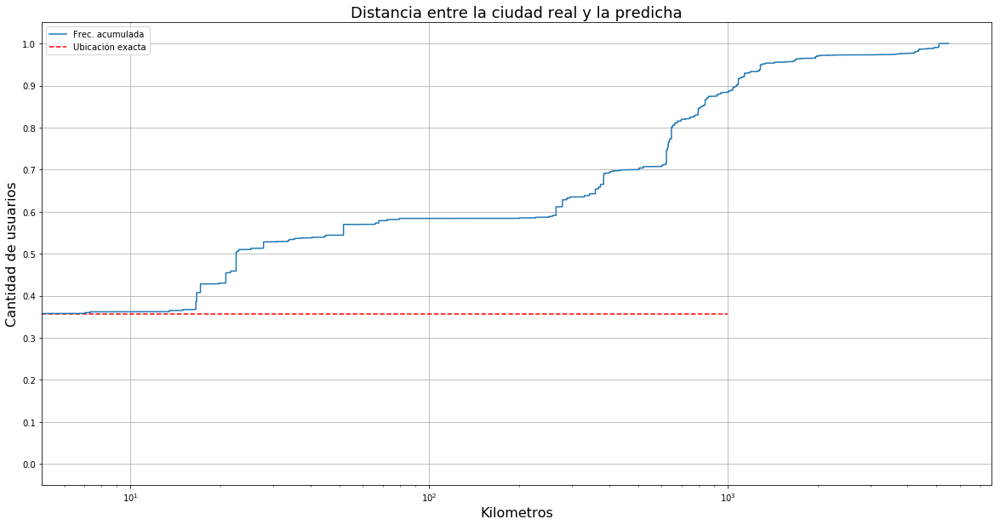

In [236]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

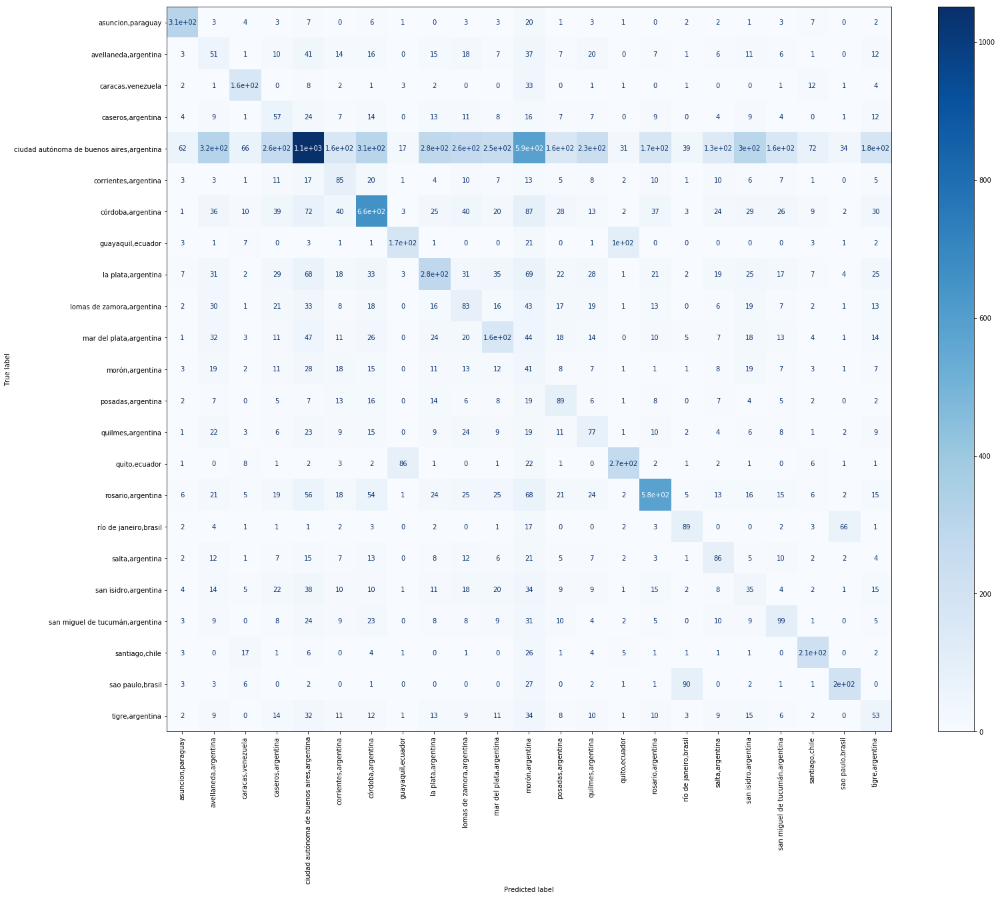

In [237]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names_mentions,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

# Hashtags y menciones - sin generar muestras

In [37]:
vectorizer = CountVectorizer(
    strip_accents="ascii",
    lowercase=True,
)

vector_of_hashtags = vectorizer.fit_transform(users_train_selected["hashtags"].apply(lambda x: ' '.join(x))).astype('bool')
vector_of_hashtags

<54099x4786 sparse matrix of type '<class 'numpy.bool_'>'
	with 231216 stored elements in Compressed Sparse Row format>

In [38]:
hashtag_list = vectorizer.get_feature_names()

In [39]:
vectorizer = CountVectorizer(
    strip_accents="ascii",
    lowercase=True,
)

vector_of_hashtags_countries = vectorizer.fit_transform(users_train_selected["mentions_country"].apply(lambda x: ' '.join(x))).astype('bool')
vector_of_hashtags_countries

<54099x15 sparse matrix of type '<class 'numpy.bool_'>'
	with 1191 stored elements in Compressed Sparse Row format>

In [40]:
mentioned_places = vectorizer.get_feature_names()

In [41]:
vectorizer = CountVectorizer(
    strip_accents="ascii",
    lowercase=True,
)

vector_of_mentions = vectorizer.fit_transform(users_train_selected["users_mentioned"].apply(lambda x: ' '.join(x))).astype('bool')
vector_of_mentions

<54099x93443 sparse matrix of type '<class 'numpy.bool_'>'
	with 795381 stored elements in Compressed Sparse Row format>

In [129]:
#mentions_list = vectorizer.get_feature_names()

In [130]:
#feature_names = hashtag_list + mentioned_places + mentions_list

In [131]:
vector = hstack([vector_of_hashtags, vector_of_hashtags_countries, vector_of_mentions])

In [246]:
X_train, X_test, y_train, y_test = train_test_split(vector, users_complete_location[:,0], test_size=0.30)

DecisionTree

In [247]:
decisiontree = DecisionTreeClassifier()
decisiontree.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [248]:
param_grid= {'max_features': [10, 20, 50, 'auto', 1000, 2000,None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1],
             'class_weight': ['balanced']}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

{'min_samples_leaf': 1, 'class_weight': 'balanced', 'max_depth': 500, 'max_features': 2000} 0.5178419936373276


In [249]:
y_predicted = grid_drop.predict(X_test)

In [250]:
accuracy_score(y_test, y_predicted)

0.5243397043359931

In [251]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


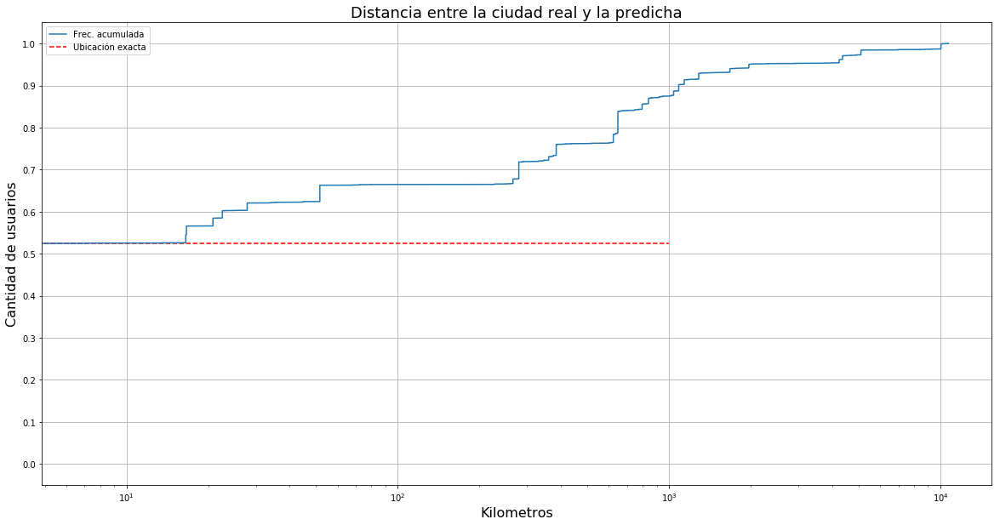

In [252]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

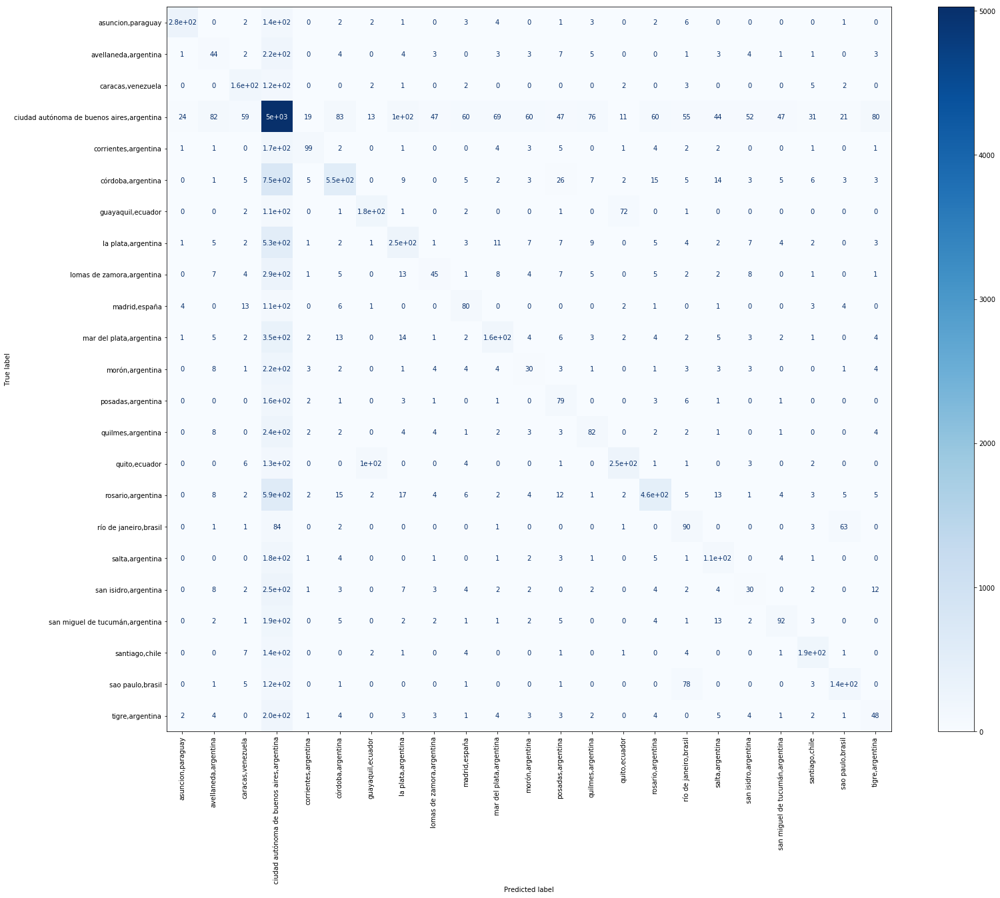

In [253]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)

# Hashtags y menciones - generando muestras aleatorias

In [133]:
X_train, X_test, y_train, y_test = train_test_split(vector, users_complete_location[:,0], test_size=0.30)

In [134]:
samples = dict(pd.DataFrame({'r':y_train})['r'].value_counts())
samples

{'asuncion,paraguay': 1050,
 'avellaneda,argentina': 816,
 'caracas,venezuela': 660,
 'ciudad autónoma de buenos aires,argentina': 14449,
 'corrientes,argentina': 689,
 'córdoba,argentina': 3288,
 'guayaquil,ecuador': 862,
 'la plata,argentina': 1967,
 'lomas de zamora,argentina': 926,
 'madrid,españa': 569,
 'mar del plata,argentina': 1384,
 'morón,argentina': 659,
 'posadas,argentina': 626,
 'quilmes,argentina': 778,
 'quito,ecuador': 1094,
 'rosario,argentina': 2658,
 'río de janeiro,brasil': 545,
 'salta,argentina': 688,
 'san isidro,argentina': 803,
 'san miguel de tucumán,argentina': 791,
 'santiago,chile': 832,
 'sao paulo,brasil': 866,
 'tigre,argentina': 720}

In [135]:
(values,counts) = np.unique(y_train,return_counts=True)
ind=np.argmax(counts)
mayority_sample_city = values[ind]
mayority_samples = counts[ind]

In [136]:
smote_undersample_dict = samples.copy()
smote_undersample_dict[mayority_sample_city] = int(mayority_samples * 0.5)
smote_undersample_dict

{'asuncion,paraguay': 1050,
 'avellaneda,argentina': 816,
 'caracas,venezuela': 660,
 'ciudad autónoma de buenos aires,argentina': 7224,
 'corrientes,argentina': 689,
 'córdoba,argentina': 3288,
 'guayaquil,ecuador': 862,
 'la plata,argentina': 1967,
 'lomas de zamora,argentina': 926,
 'madrid,españa': 569,
 'mar del plata,argentina': 1384,
 'morón,argentina': 659,
 'posadas,argentina': 626,
 'quilmes,argentina': 778,
 'quito,ecuador': 1094,
 'rosario,argentina': 2658,
 'río de janeiro,brasil': 545,
 'salta,argentina': 688,
 'san isidro,argentina': 803,
 'san miguel de tucumán,argentina': 791,
 'santiago,chile': 832,
 'sao paulo,brasil': 866,
 'tigre,argentina': 720}

In [137]:
undersample = RandomUnderSampler(sampling_strategy=smote_undersample_dict)
X_train, y_train = undersample.fit_resample(X_train, y_train)

In [138]:
(values,counts) = np.unique(y_train,return_counts=True)
ind=np.argmax(counts)
mayority_sample_city = values[ind]
mayority_samples = counts[ind]
print(mayority_sample_city, mayority_samples)

ciudad autónoma de buenos aires,argentina 7224


In [139]:
smote_oversample_dict = dict(map(lambda x: [x[1], int(mayority_samples * 1.0)], np.ndenumerate(y_train)))

In [140]:
del smote_oversample_dict[mayority_sample_city]

In [141]:
smote_oversample_dict

{'asuncion,paraguay': 7224,
 'avellaneda,argentina': 7224,
 'caracas,venezuela': 7224,
 'corrientes,argentina': 7224,
 'córdoba,argentina': 7224,
 'guayaquil,ecuador': 7224,
 'la plata,argentina': 7224,
 'lomas de zamora,argentina': 7224,
 'madrid,españa': 7224,
 'mar del plata,argentina': 7224,
 'morón,argentina': 7224,
 'posadas,argentina': 7224,
 'quilmes,argentina': 7224,
 'quito,ecuador': 7224,
 'rosario,argentina': 7224,
 'río de janeiro,brasil': 7224,
 'salta,argentina': 7224,
 'san isidro,argentina': 7224,
 'san miguel de tucumán,argentina': 7224,
 'santiago,chile': 7224,
 'sao paulo,brasil': 7224,
 'tigre,argentina': 7224}

In [142]:
oversample = SMOTE(sampling_strategy=smote_oversample_dict)
X_train, y_train = oversample.fit_resample(X_train, y_train)

In [143]:
pd.DataFrame({'r':y_train})['r'].value_counts()

tigre,argentina                              7224
río de janeiro,brasil                        7224
rosario,argentina                            7224
asuncion,paraguay                            7224
sao paulo,brasil                             7224
posadas,argentina                            7224
san isidro,argentina                         7224
santiago,chile                               7224
quilmes,argentina                            7224
madrid,españa                                7224
salta,argentina                              7224
san miguel de tucumán,argentina              7224
quito,ecuador                                7224
lomas de zamora,argentina                    7224
corrientes,argentina                         7224
ciudad autónoma de buenos aires,argentina    7224
córdoba,argentina                            7224
mar del plata,argentina                      7224
avellaneda,argentina                         7224
guayaquil,ecuador                            7224


DecisionTree

In [144]:
decisiontree = DecisionTreeClassifier()
decisiontree.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_impurity_split': None,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'presort': 'deprecated',
 'random_state': None,
 'splitter': 'best'}

In [145]:
param_grid= {'max_features': [10, 20, 50, 'auto', 1000, 2000,None], 'max_depth': [8, 80, 200, 500, None], 'min_samples_leaf': [1],
             'class_weight': [None], 'min_impurity_decrease': [0.01, 0.001, 0.0001,  0.00001, 0.000001]}#, 'min_samples_split': [2500]}
grid_drop = GridSearchCV(decisiontree, param_grid, cv=5, scoring='accuracy')
grid_drop.fit(X_train, y_train)
print(grid_drop.best_params_, grid_drop.best_score_)

{'max_depth': None, 'class_weight': None, 'min_samples_leaf': 1, 'max_features': 2000} 0.5140412911152134


In [146]:
y_predicted = grid_drop.predict(X_test)

In [147]:
accuracy_score(y_test, y_predicted)

0.346632028205604

In [148]:
distances_predicted = get_difference_distance(
    y_predicted,
    y_test
)

Total NaN:  0


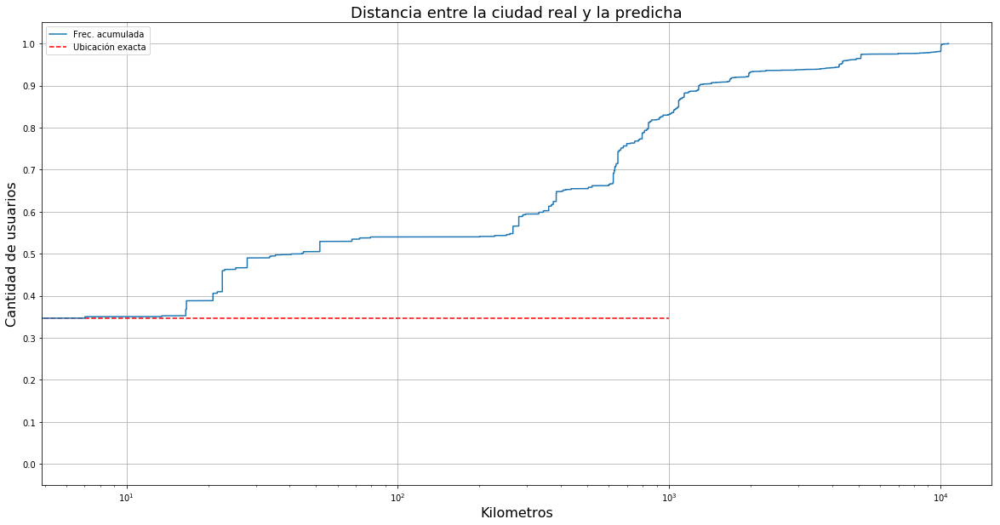

In [149]:
ecdf = ECDF(distances_predicted)

plt.figure(figsize=(20,10)) 
plt.grid(b=True, which='major')
plt.xlabel("Kilometros", fontsize=16)
plt.ylabel("Cantidad de usuarios", fontsize=16)
plt.title("Distancia entre la ciudad real y la predicha", fontsize=18)
plt.plot(ecdf.x,ecdf.y)
plt.yticks(np.arange(0,1.1,0.1))
#plt.x
#plt.xticks(np.arange(0,1000,50))
plt.xscale('log')
plt.hlines(accuracy_score(y_test, y_predicted), -200, 1000, colors='r', linestyles='dashed')
plt.legend(["Frec. acumulada", "Ubicación exacta"])
plt.show()

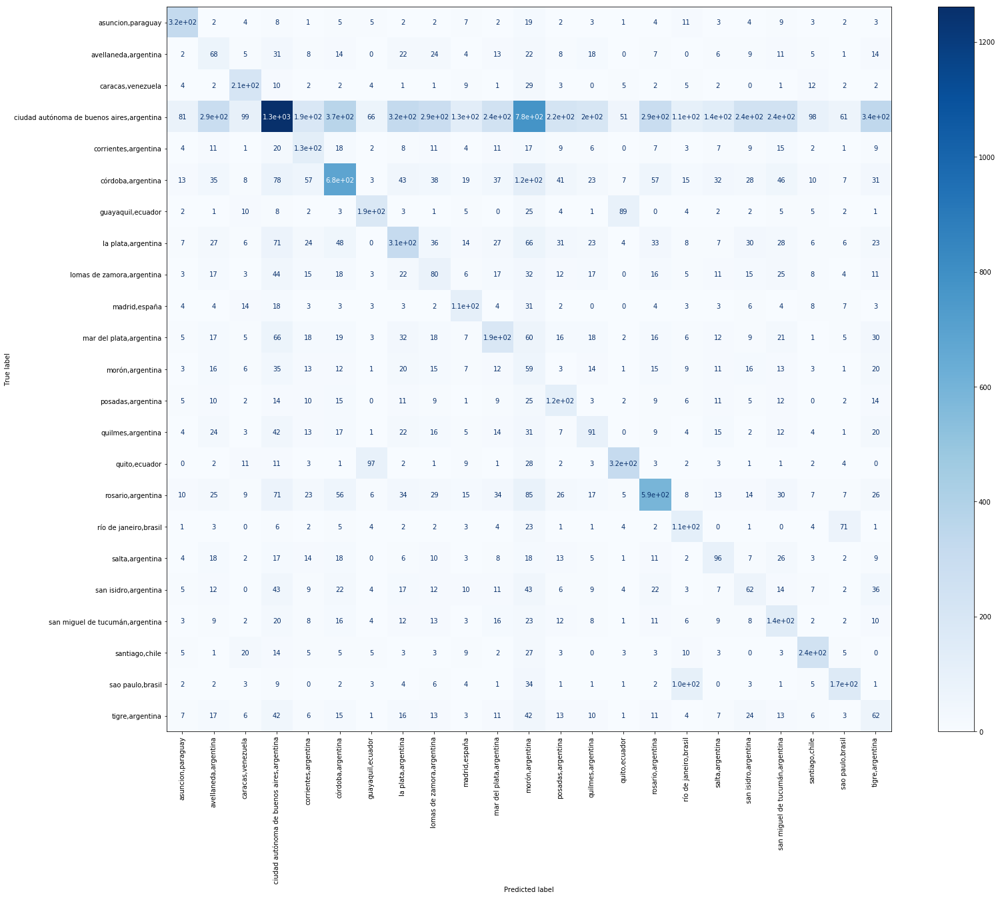

In [150]:
fig, ax = plt.subplots()
fig.set_size_inches(25, 20)
disp = plot_confusion_matrix(grid_drop.best_estimator_, X_test, y_test,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,
                                 normalize=None,
                                xticks_rotation='vertical',
                            ax=ax)